In [398]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
import cv2
from sklearn.externals import joblib

In [5]:
cwd = os.getcwd()

folder = 'spotgarbage'
path = os.path.join(cwd, folder)


In [6]:
garbageData_file = pd.read_csv('garbage-queried-images.csv')
non_garbageData_file = pd.read_csv('non-garbage-queried-images.csv')

In [7]:
garbageData_file.head()

,image,query,label,startX,startY,endX,endY
0,398faec8-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,18.0,113.0,528.0,427.0
1,3adba2c8-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,NaN,NaN,NaN,NaN,NaN
2,46e3e5ee-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,188.0,183.0,553.0,401.0
3,47e1b9a8-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,NaN,NaN,NaN,NaN,NaN
4,495f1dca-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,270.0,306.0,369.0,340.0


In [8]:
non_garbageData_file.head()

,image,query
0,5cb4b058-9447-11e5-9ae8-40f2e96c8ad8.JPG,buildings
1,adde4386-9447-11e5-9ae8-40f2e96c8ad8.jpg,buildings
2,38b3f02e-9447-11e5-9ae8-40f2e96c8ad8.jpg,buildings
3,85b29db2-9447-11e5-9ae8-40f2e96c8ad8.jpg,buildings
4,72667936-9447-11e5-9ae8-40f2e96c8ad8.jpg,buildings


In [9]:
incomplete_rows = garbageData_file.isnull().any(axis=1)
garbageData_file = garbageData_file[incomplete_rows == False]
garbageData_file.head()

,image,query,label,startX,startY,endX,endY
0,398faec8-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,18.0,113.0,528.0,427.0
2,46e3e5ee-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,188.0,183.0,553.0,401.0
4,495f1dca-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,270.0,306.0,369.0,340.0
5,4c3d9cb0-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,3.0,24.0,633.0,449.0
8,894d0654-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,167.0,41.0,429.0,327.0


## Data Cleaning

#### Skip Data Cleaning if already done

OUTER LOOP  1 


INNER LOOP 1 


0 	                                       image         query  label  startX  \
0  398faec8-6799-11e5-8dc4-40f2e96c8ad8.jpg  city garbage    1.0    18.0   

   startY   endX   endY  
0   113.0  528.0  427.0  
Success 1


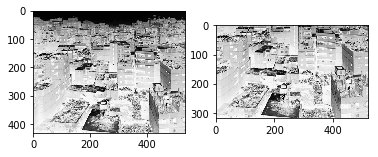





1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	                                       image         query  label  startX  \
2  46e3e5ee-6799-11e5-8dc4-40f2e96c8ad8.jpg  city garbage    1.0   188.0   

   startY   endX   endY  
2   183.0  553.0  401.0  
Success 2


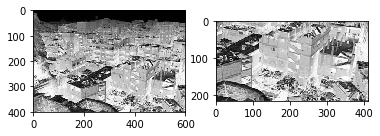





3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	                                       image         query  label  startX  \
4  495f1dca-6799-11e5-8dc4-40f2e96c8ad8.jpg  city garbage    1.0   270.0   

   startY   endX   endY  
4   306.0  369.0  340.0  
Success 3


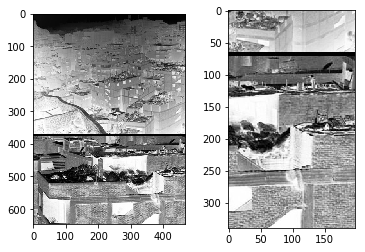





5 	                                       image         query  label  startX  \
5  4c3d9cb0-6799-11e5-8dc4-40f2e96c8ad8.jpg  city garbage    1.0     3.0   

   startY   endX   endY  
5    24.0  633.0  449.0  
Success 4


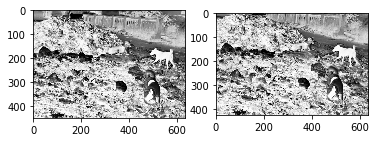





6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	                                       image         query  label  startX  \
8  894d0654-6799-11e5-8dc4-40f2e96c8ad8.jpg  city garbage    1.0   167.0   

   startY   endX   endY  
8    41.0  429.0  327.0  
Success 5


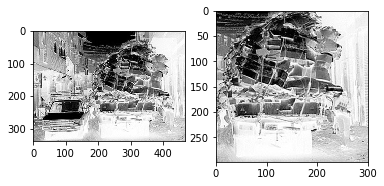





9 	                                       image         query  label  startX  \
9  8c1b5552-6799-11e5-8dc4-40f2e96c8ad8.jpg  city garbage    1.0   138.0   

   startY   endX   endY  
9   216.0  244.0  340.0  
Success 6


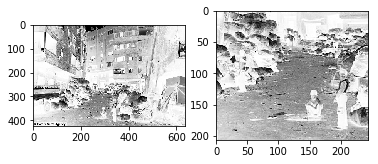





10 	                                        image         query  label  startX  \
10  8d1faf66-6799-11e5-8dc4-40f2e96c8ad8.jpg  city garbage    1.0   191.0   

    startY   endX   endY  
10   235.0  413.0  391.0  
Success 7


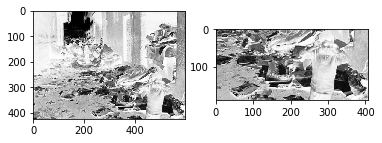





INNER LOOP 2 


0 	                                        image          query  label  startX  \
11  911108a4-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0    71.0   

    startY   endX   endY  
11    90.0  456.0  252.0  
Success 1


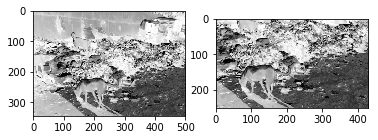





1 	                                        image          query  label  startX  \
12  9282d0c8-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0   125.0   

    startY   endX   endY  
12   158.0  650.0  400.0  
Success 2


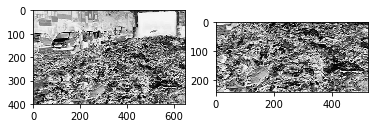





2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	                                        image          query  label  startX  \
14  92ff7cae-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0   360.0   

    startY   endX   endY  
14   178.0  585.0  351.0  
Success 3


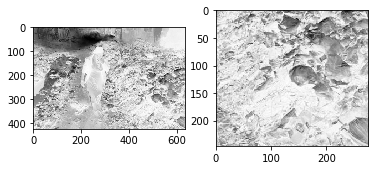





4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	                                        image          query  label  startX  \
16  95a65b44-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0    31.0   

    startY   endX   endY  
16   139.0  660.0  513.0  
Success 4


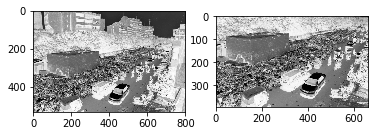





6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	                                        image          query  label  startX  \
19  967550c0-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0    85.0   

    startY   endX   endY  
19   158.0  601.0  250.0  
Success 5


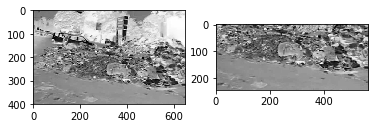





9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	                                        image          query  label  startX  \
22  9aca41b2-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0    28.0   

    startY   endX   endY  
22   175.0  472.0  323.0  
Success 6


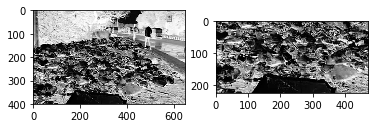





12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	                                        image          query  label  startX  \
31  a477c630-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0    64.0   

    startY   endX   endY  
31    83.0  325.0  185.0  
Success 7


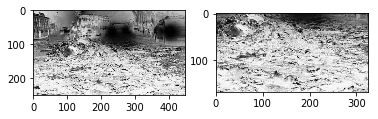





20 	                                        image          query  label  startX  \
32  a4e60b40-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0   301.0   

    startY   endX   endY  
32   116.0  741.0  417.0  
Success 8


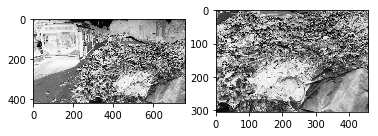





21 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
22 	                                        image          query  label  startX  \
34  a87af798-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0     0.0   

    startY   endX   endY  
34   175.0  759.0  422.0  
Success 9


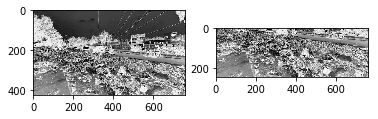





23 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
24 	                                        image          query  label  startX  \
36  aa08e41c-6799-11e5-ba3c-40f2e96c8ad8.jpg  delhi garbage    1.0   105.0   

    startY   endX   endY  
36    84.0  454.0  330.0  
Success 10


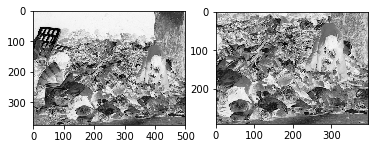





INNER LOOP 3 


0 	                                        image             query  label  startX  \
60  3656eb04-679e-11e5-990f-40f2e96c8ad8.jpg  footpath garbage    1.0   563.0   

    startY   endX   endY  
60   589.0  857.0  701.0  
Success 1


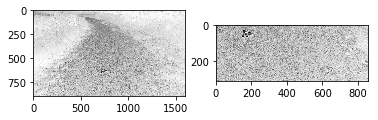





1 	                                        image             query  label  startX  \
61  368e196c-679e-11e5-990f-40f2e96c8ad8.JPG  footpath garbage    1.0   148.0   

    startY   endX   endY  
61   358.0  944.0  669.0  
Success 2


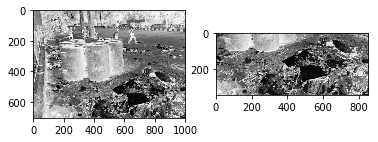





2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	                                        image             query  label  startX  \
63  37afc994-679e-11e5-990f-40f2e96c8ad8.jpg  footpath garbage    1.0     1.0   

    startY   endX   endY  
63   155.0  364.0  355.0  
Success 3


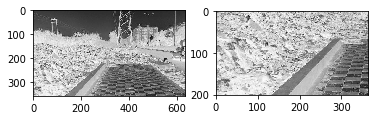





4 	                                        image             query  label  startX  \
64  393e21b6-679e-11e5-990f-40f2e96c8ad8.jpg  footpath garbage    1.0   448.0   

    startY    endX    endY  
64   666.0  1757.0  1002.0  
Success 4


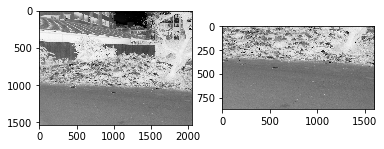





5 	                                        image             query  label  startX  \
65  3ac78f4a-679e-11e5-990f-40f2e96c8ad8.jpg  footpath garbage    1.0    43.0   

    startY   endX   endY  
65   142.0  581.0  442.0  
Success 5


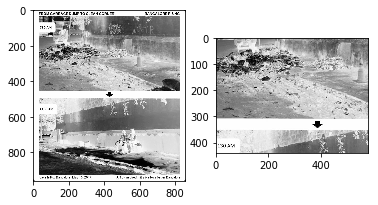





6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	                                        image             query  label  startX  \
69  4124c6f0-679e-11e5-990f-40f2e96c8ad8.jpg  footpath garbage    1.0   253.0   

    startY   endX   endY  
69   132.0  353.0  171.0  
Success 6


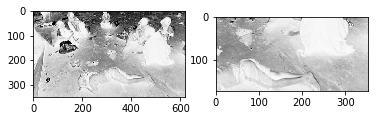





10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	                                        image             query  label  startX  \
71  434b6d30-679e-11e5-990f-40f2e96c8ad8.jpg  footpath garbage    1.0    38.0   

    startY   endX   endY  
71   130.0  358.0  265.0  
Success 7


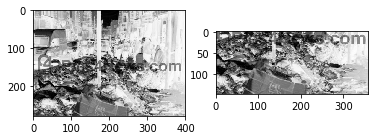





12 	                                        image             query  label  startX  \
72  445171ac-679e-11e5-990f-40f2e96c8ad8.jpg  footpath garbage    1.0   385.0   

    startY   endX   endY  
72    90.0  628.0  423.0  
Success 8


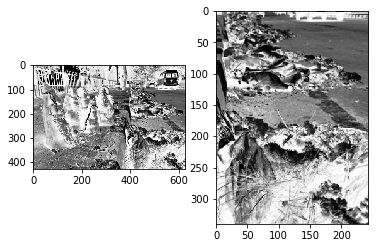





13 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
14 	                                        image             query  label  startX  \
74  4692d8f2-679e-11e5-990f-40f2e96c8ad8.jpg  footpath garbage    1.0   164.0   

    startY   endX   endY  
74   155.0  599.0  346.0  
Success 9


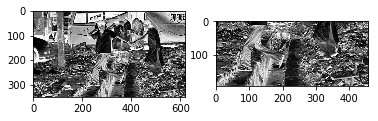





15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	                                        image             query  label  startX  \
81  538191f2-679e-11e5-990f-40f2e96c8ad8.jpg  footpath garbage    1.0   292.0   

    startY   endX   endY  
81    25.0  624.0  389.0  
Success 10


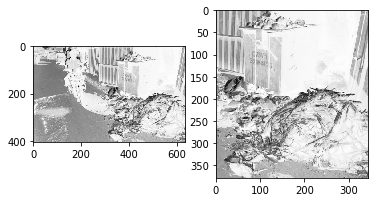





INNER LOOP 4 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	                                         image    query  label  startX  startY  \
115  0b759b0c-6798-11e5-8c9e-40f2e96c8ad8.jpg  garbage    1.0   149.0    68.0   

      endX   endY  
115  397.0  412.0  
Success 1


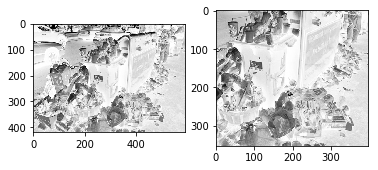





6 	                                         image    query  label  startX  startY  \
116  0d61b8e2-6798-11e5-8c9e-40f2e96c8ad8.jpg  garbage    1.0   770.0  1114.0   

       endX    endY  
116  2369.0  1620.0  
Success 2


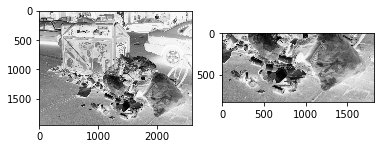





7 	                                         image    query  label  startX  startY  \
117  18ba4d4e-6798-11e5-8c9e-40f2e96c8ad8.jpg  garbage    1.0    68.0    60.0   

       endX    endY  
117  1523.0  1153.0  
Success 3


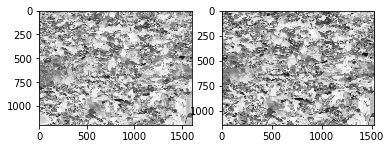





8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	                                         image    query  label  startX  startY  \
119  216b454c-6798-11e5-8c9e-40f2e96c8ad8.JPG  garbage    1.0   350.0   354.0   

       endX   endY  
119  1280.0  959.0  
Success 4


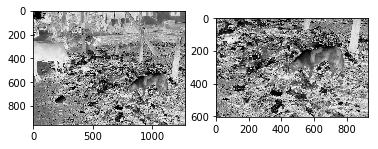





10 	                                         image    query  label  startX  startY  \
120  2353aa7a-6798-11e5-8c9e-40f2e96c8ad8.jpg  garbage    1.0    99.0   167.0   

      endX   endY  
120  627.0  413.0  
Success 5


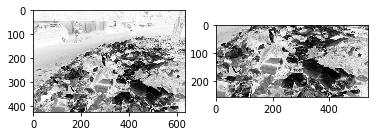





11 	                                         image    query  label  startX  startY  \
121  24e2f102-6798-11e5-8c9e-40f2e96c8ad8.jpg  garbage    1.0    52.0    55.0   

      endX   endY  
121  560.0  128.0  
Success 6


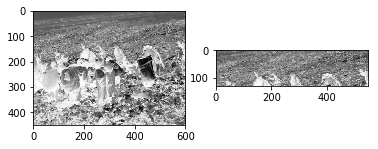





12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	                                         image    query  label  startX  startY  \
123  2658e0b4-6798-11e5-8c9e-40f2e96c8ad8.jpg  garbage    1.0    60.0   317.0   

       endX    endY  
123  1920.0  1276.0  
Success 7


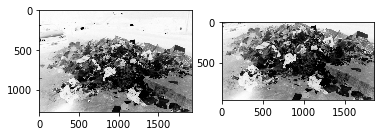





14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	                                         image    query  label  startX  startY  \
126  2c434712-6798-11e5-8c9e-40f2e96c8ad8.jpg  garbage    1.0   187.0   168.0   

      endX   endY  
126  530.0  398.0  
Success 8


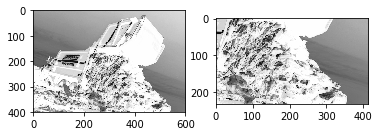





17 	                                         image    query  label  startX  startY  \
127  2d77892c-6798-11e5-8c9e-40f2e96c8ad8.jpg  garbage    1.0     2.0     2.0   

      endX   endY  
127  460.0  300.0  
Success 9


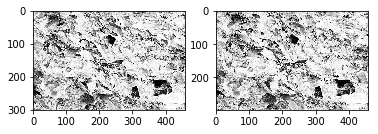





18 	                                         image    query  label  startX  startY  \
128  3013ed38-6798-11e5-8c9e-40f2e96c8ad8.jpg  garbage    1.0    12.0    84.0   

      endX   endY  
128  283.0  218.0  
Success 10


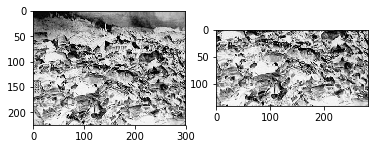





INNER LOOP 5 


0 	                                         image                  query  label  \
159  004633f2-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY    endX    endY  
159    65.0  1498.0  4543.0  3398.0  
Success 1


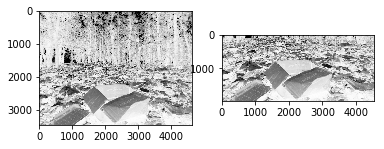





1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	                                         image                  query  label  \
162  092d0216-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY   endX   endY  
162   131.0   244.0  425.0  432.0  
Success 2


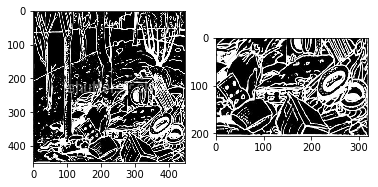





4 	                                         image                  query  label  \
163  0bd7f188-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY   endX   endY  
163    61.0    14.0  359.0  224.0  
Success 3


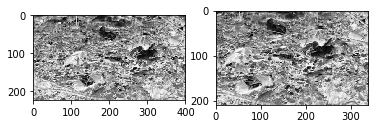





5 	                                         image                  query  label  \
164  0eb3e722-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY   endX   endY  
164    45.0   102.0  593.0  351.0  
Success 4


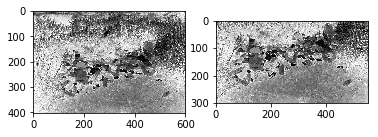





6 	                                         image                  query  label  \
165  122a3e88-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY   endX   endY  
165     1.0   146.0  450.0  245.0  
Success 5


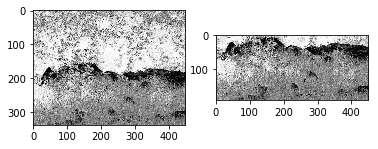





7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	                                         image                  query  label  \
170  173e1a02-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY    endX   endY  
170   253.0   339.0  1166.0  666.0  
Success 6


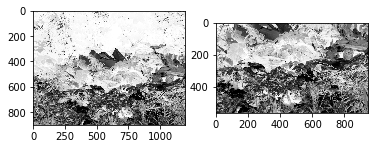





12 	                                         image                  query  label  \
171  1a063d14-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY   endX   endY  
171   202.0   102.0  718.0  418.0  
Success 7


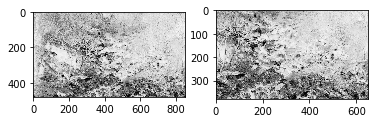





13 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
14 	                                         image                  query  label  \
173  2046f038-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY   endX   endY  
173   105.0   162.0  802.0  452.0  
Success 8


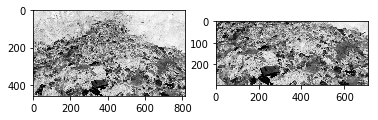





15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	                                         image                  query  label  \
175  25cbd6f4-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY    endX   endY  
175   380.0   394.0  1032.0  684.0  
Success 9


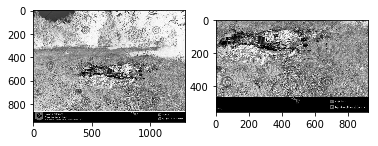





17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	                                         image                  query  label  \
177  28a0beee-679f-11e5-b0e3-40f2e96c8ad8.jpg  garbage in the forest    1.0   

     startX  startY   endX   endY  
177    54.0   330.0  423.0  596.0  
Success 10


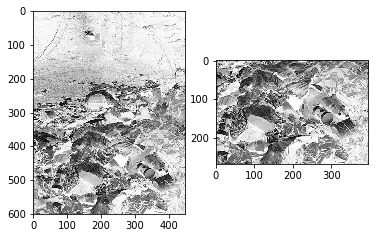





INNER LOOP 6 


0 	                                         image             query  label  \
206  6c416976-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY   endX   endY  
206    11.0    73.0  252.0  190.0  
Success 1


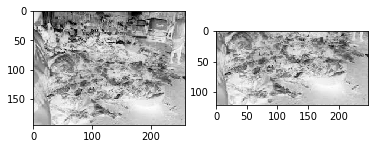





1 	                                         image             query  label  \
207  6c669174-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY    endX    endY  
207   477.0   659.0  1843.0  1458.0  
Success 2


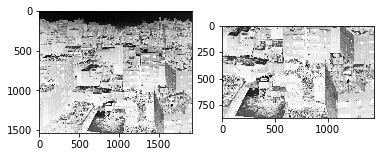





2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	                                         image             query  label  \
212  7935b10a-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY   endX   endY  
212    70.0    64.0  489.0  346.0  
Success 3


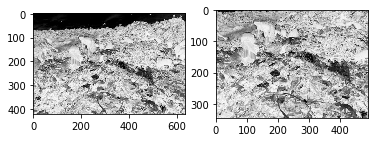





7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	                                         image             query  label  \
215  7ed5e8aa-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY    endX    endY  
215   203.0   100.0  2480.0  1504.0  
Success 4


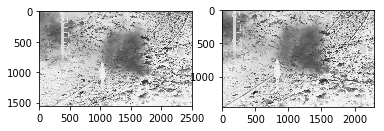





10 	                                         image             query  label  \
216  822e2be8-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY   endX   endY  
216   149.0   109.0  311.0  300.0  
Success 5


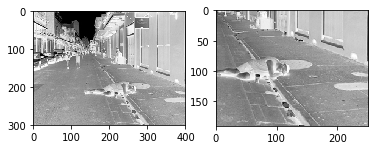





11 	                                         image             query  label  \
217  8470c168-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY   endX   endY  
217    13.0    44.0  188.0  267.0  
Success 6


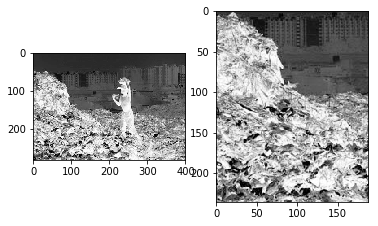





12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	                                         image             query  label  \
219  8519e52c-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY   endX   endY  
219    23.0   222.0  488.0  375.0  
Success 7


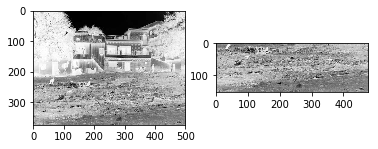





14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	                                         image             query  label  \
221  8898e540-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY   endX   endY  
221   162.0   381.0  689.0  449.0  
Success 8


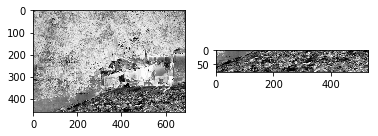





16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	                                         image             query  label  \
227  9aa61f1e-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY   endX   endY  
227   107.0   360.0  726.0  464.0  
Success 9


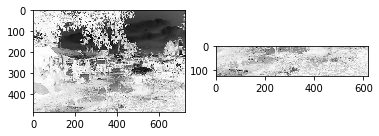





22 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
23 	                                         image             query  label  \
229  9caf5a46-67a1-11e5-b4c6-40f2e96c8ad8.jpg  india dirty city    1.0   

     startX  startY   endX   endY  
229     2.0   175.0  613.0  397.0  
Success 10


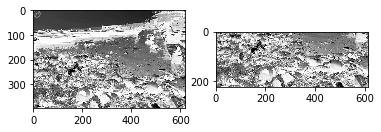





INNER LOOP 7 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	                                         image                query  label  \
252  6175e0b8-67a0-11e5-a3d2-40f2e96c8ad8.jpg  india dirty streets    1.0   

     startX  startY   endX   endY  
252    82.0   538.0  265.0  683.0  
Success 1


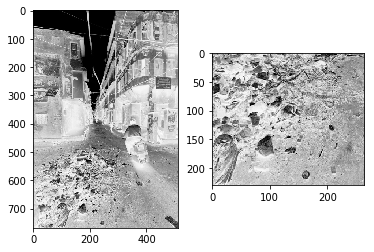





2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	                                         image                query  label  \
256  67874d34-67a0-11e5-a3d2-40f2e96c8ad8.jpg  india dirty streets    1.0   

     startX  startY   endX   endY  
256   207.0   158.0  396.0  271.0  
Success 2


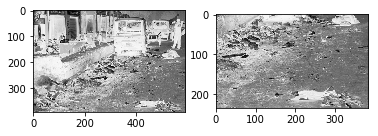





6 	                                         image                query  label  \
257  6a111620-67a0-11e5-a3d2-40f2e96c8ad8.jpg  india dirty streets    1.0   

     startX  startY   endX   endY  
257   103.0   166.0  413.0  287.0  
Success 3


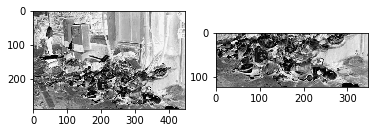





7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	                                         image                query  label  \
259  6d786430-67a0-11e5-a3d2-40f2e96c8ad8.jpg  india dirty streets    1.0   

     startX  startY   endX   endY  
259    22.0   220.0  498.0  334.0  
Success 4


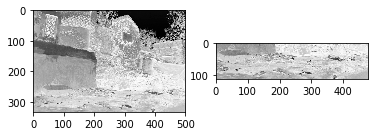





9 	                                         image                query  label  \
260  6e93fcee-67a0-11e5-a3d2-40f2e96c8ad8.jpg  india dirty streets    1.0   

     startX  startY   endX   endY  
260    52.0   234.0  552.0  382.0  
Success 5


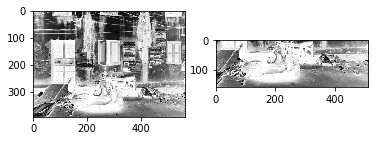





10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	                                         image                query  label  \
264  712e0d14-67a0-11e5-a3d2-40f2e96c8ad8.jpg  india dirty streets    1.0   

     startX  startY   endX   endY  
264   183.0   171.0  523.0  313.0  
Success 6


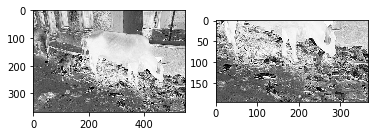





14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	                                         image                query  label  \
266  7257b712-67a0-11e5-a3d2-40f2e96c8ad8.jpg  india dirty streets    1.0   

     startX  startY   endX   endY  
266    64.0   255.0  541.0  366.0  
Success 7


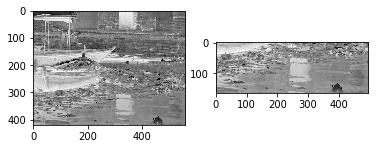





16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	                                         image                query  label  \
270  7bbf1296-67a0-11e5-a3d2-40f2e96c8ad8.JPG  india dirty streets    1.0   

     startX  startY   endX   endY  
270   313.0   351.0  950.0  859.0  
Success 8


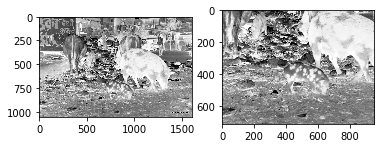





20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
22 	                                         image                query  label  \
273  7e31ff98-67a0-11e5-a3d2-40f2e96c8ad8.jpg  india dirty streets    1.0   

     startX  startY  endX   endY  
273    18.0   314.0  97.0  405.0  
Success 9


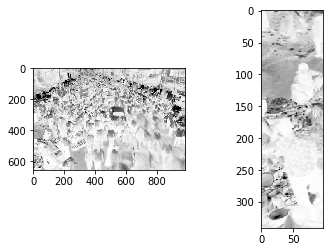





23 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
24 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
25 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
26 	                                         image                query  label  \
277  87cfa26c-67a0-11e5-a3d2-40f2e96c8ad8.jpg  india dirty streets    1.0   

     startX  startY   endX   endY  
277    46.0   184.0  736.0  370.0  
Success 10


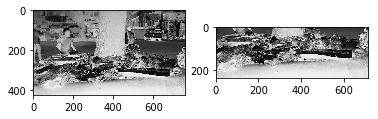





INNER LOOP 8 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	                                         image          query  label  startX  \
300  35b6590e-679f-11e5-893c-40f2e96c8ad8.jpg  kitchen waste    1.0    76.0   

     startY   endX   endY  
300   114.0  420.0  259.0  
Success 1


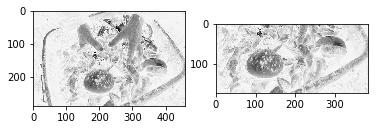





3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	                                         image          query  label  startX  \
303  3e6060ea-679f-11e5-893c-40f2e96c8ad8.jpg  kitchen waste    1.0     7.0   

     startY   endX   endY  
303     9.0  417.0  266.0  
Success 2


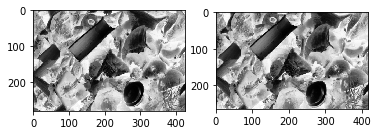





6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	                                         image          query  label  startX  \
313  53ee47d8-679f-11e5-893c-40f2e96c8ad8.jpg  kitchen waste    1.0   315.0   

     startY    endX   endY

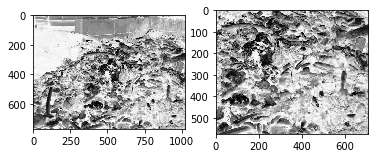





16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
22 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
23 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
24 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
25 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
26 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
27 	 E

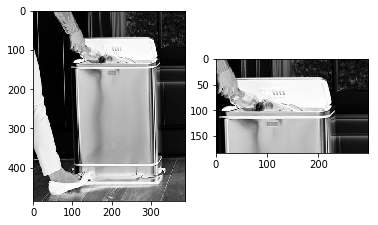





30 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
31 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
32 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
33 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
34 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
35 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
36 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
37 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
38 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
39 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
40 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
41 	 E

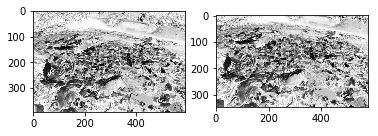





1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	                                         image   query  label  startX  startY  \
349  60108448-679c-11e5-aa4a-40f2e96c8ad8.jpg  litter    1.0    88.0   362.0   

       endX   endY  
349  1258.0  960.0  
Success 2


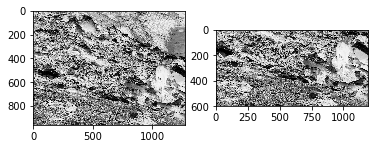





4 	                                         image   query  label  startX  startY  \
350  60763e3c-679c-11e5-aa4a-40f2e96c8ad8.jpg  litter    1.0    18.0   217.0   

      endX   endY  
350  878.0  650.0  
Success 3


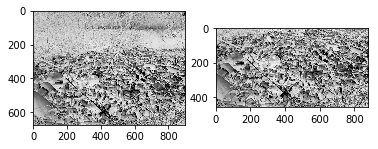





5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	                                         image   query  label  startX  startY  \
353  6a336f44-679c-11e5-aa4a-40f2e96c8ad8.jpg  litter    1.0   590.0   379.0   

       endX   endY  
353  1215.0  725.0  
Success 4


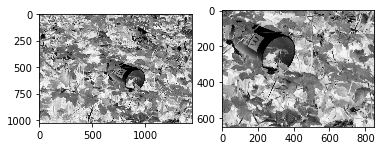





8 	                                         image   query  label  startX  startY  \
354  6a97ec44-679c-11e5-aa4a-40f2e96c8ad8.jpg  litter    1.0   515.0   157.0   

       endX    endY  
354  2213.0  1712.0  
Success 5


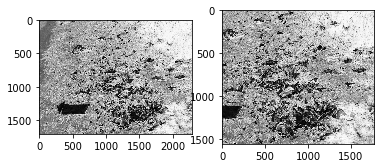





9 	                                         image   query  label  startX  startY  \
355  76c5d102-679c-11e5-aa4a-40f2e96c8ad8.jpg  litter    1.0   675.0  1037.0   

       endX    endY  
355  1200.0  1600.0  
Success 6


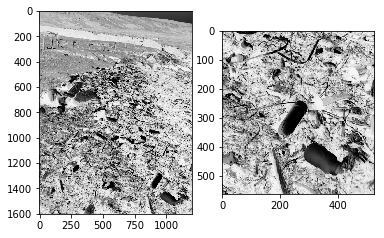





10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	                                         image   query  label  startX  startY  \
359  84324a46-679c-11e5-aa4a-40f2e96c8ad8.jpg  litter    1.0    82.0   380.0   

       endX   endY  
359  1196.0  912.0  
Success 7


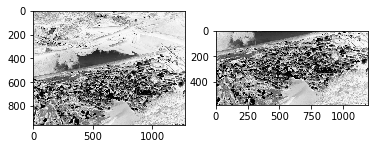





14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	                                         image   query  label  startX  startY  \
362  8d3dcd36-679c-11e5-aa4a-40f2e96c8ad8.JPG  litter    1.0    73.0   567.0   

       endX    endY  
362  3830.0  2587.0  
Success 8


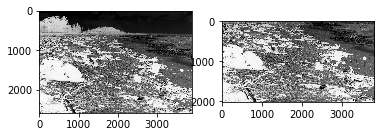





17 	                                         image   query  label  startX  startY  \
363  91406178-679c-11e5-aa4a-40f2e96c8ad8.jpg  litter    1.0    56.0   239.0   

      endX   endY  
363  342.0  390.0  
Success 9


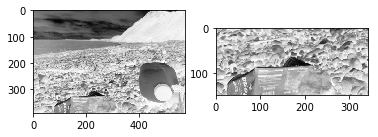





18 	                                         image   query  label  startX  startY  \
364  93117578-679c-11e5-aa4a-40f2e96c8ad8.jpg  litter    1.0   161.0    66.0   

      endX   endY  
364  462.0  364.0  
Success 10


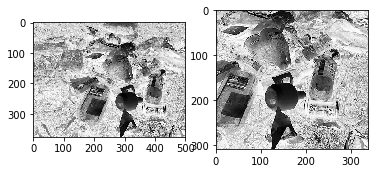





INNER LOOP 10 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	                                         image         query  label  startX  \
395  0dfb0572-679a-11e5-80ca-40f2e96c8ad8.jpg  market waste    1.0     5.0   

     startY   endX   endY  
395     7.0  459.0  316.0  
Success 1


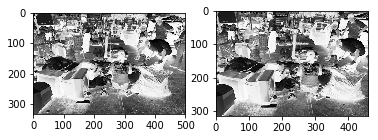





3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
14 	         

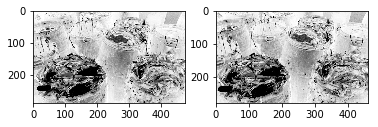





15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
22 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
23 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
24 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
25 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
26 	 E

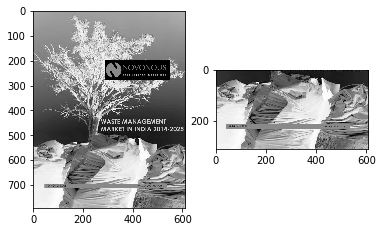





29 	                                         image         query  label  startX  \
422  7757db94-679a-11e5-80ca-40f2e96c8ad8.jpg  market waste    1.0    30.0   

     startY   endX   endY  
422   140.0  238.0  214.0  
Success 4


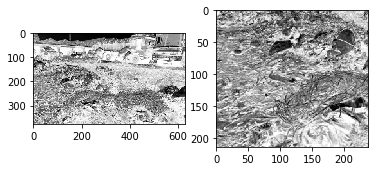





30 	                                         image         query  label  startX  \
423  78baa778-679a-11e5-80ca-40f2e96c8ad8.jpg  market waste    1.0    79.0   

     startY   endX   endY  
423    45.0  481.0  272.0  
Success 5


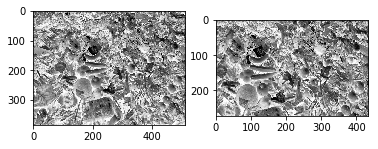





31 	                                         image         query  label  startX  \
424  7aa9dbda-679a-11e5-80ca-40f2e96c8ad8.jpg  market waste    1.0    91.0   

     startY   endX   endY  
424    81.0  285.0  212.0  
Success 6


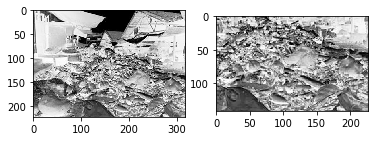





32 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
33 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
34 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
35 	                                         image         query  label  startX  \
428  d8fa3d0c-6799-11e5-80ca-40f2e96c8ad8.jpg  market waste    1.0     0.0   

     startY   endX   endY  
428   108.0  450.0  335.0  
Success 7


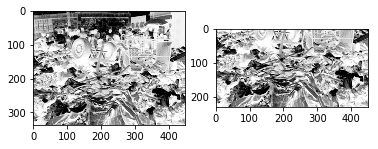





36 	                                         image         query  label  startX  \
429  da3c3ad0-6799-11e5-80ca-40f2e96c8ad8.jpg  market waste    1.0    70.0   

     startY   endX   endY  
429    74.0  585.0  396.0  
Success 8


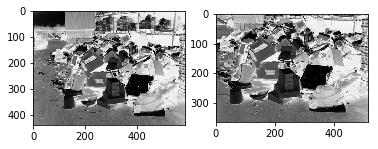





37 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
38 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
39 	                                         image         query  label  startX  \
432  e08aa49e-6799-11e5-80ca-40f2e96c8ad8.jpg  market waste    1.0   694.0   

     startY    endX    endY  
432   816.0  1913.0  1931.0  
Success 9


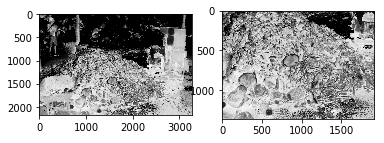





40 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
41 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
42 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
43 	                                         image         query  label  startX  \
436  eac25830-6799-11e5-80ca-40f2e96c8ad8.jpg  market waste    1.0    94.0   

     startY    endX    endY  
436   367.0  2449.0  1034.0  
Success 10


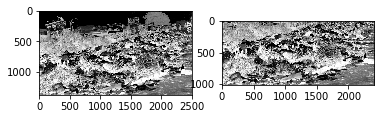





INNER LOOP 11 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	                                         image          query  label  startX  \
444  8bce1fca-679a-11e5-9696-40f2e96c8ad8.jpg  medical waste    1.0    40.0   

     startY   endX   endY  
444    20.0  315.0  297.0  
Success 1


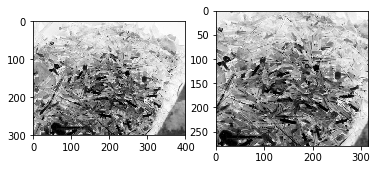





7 	                                         image          query  label  startX  \
445  8f6fb3e6-679a-11e5-9696-40f2e96c8ad8.jpg  medical waste    1.0    67.0   

     startY    endX    endY  
445    80.0  1971.0  1462.0  
Success 2


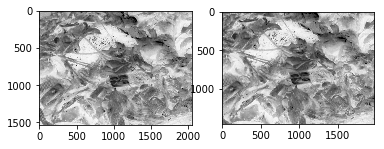





8 	                                         image          query  label  startX  \
446  91602af0-679a-11e5-9696-40f2e96c8ad8.jpg  medical waste    1.0    32.0   

     startY   endX   endY  
446    71.0  854.0  581.0  
Success 3


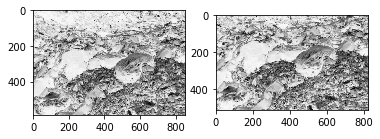





9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	                                         image          query  label  startX  \
448  980b5fd2-679a-11e5-9696-40f2e96c8ad8.jpg  medical waste    1.0   199.0   

     startY   endX   endY  
448    65.0  512.0  234.0  
Success 4


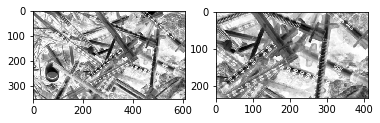





11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	                                         image          query  label  startX  \
450  9b312eee-679a-11e5-9696-40f2e96c8ad8.jpg  medical waste    1.0   388.0   

     startY    endX   endY  
450   417.0  1276.0  976.0  
Success 5


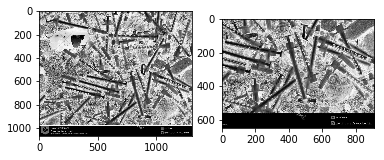





13 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
14 	                                          image          query  label  startX  \
452  9e1824be-679a-11e5-9696-40f2e96c8ad8.jpeg  medical waste    1.0    24.0   

     startY   endX   endY  
452    69.0  299.0  159.0  
Success 6


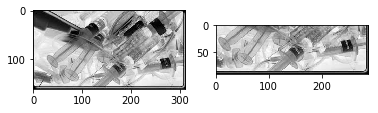





15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	                                         image          query  label  startX  \
456  a7f6caa8-679a-11e5-9696-40f2e96c8ad8.jpg  medical waste    1.0    72.0   

     startY   endX   endY  
456   120.0  588.0  346.0  
Success 7


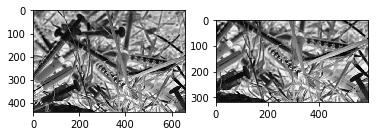





19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	                                         image          query  label  startX  \
458  b24563b6-679a-11e5-9696-40f2e96c8ad8.jpg  medical waste    1.0   256.0   

     startY   endX   endY  
458   211.0  524.0  421.0  
Success 8


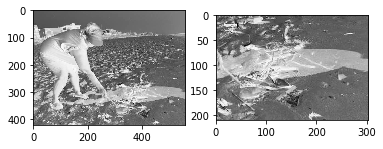





21 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
22 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
23 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
24 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
25 	                                         image          query  label  startX  \
463  bb838188-679a-11e5-9696-40f2e96c8ad8.jpg  medical waste    1.0   113.0   

     startY   endX   endY  
463   100.0  562.0  454.0  
Success 9


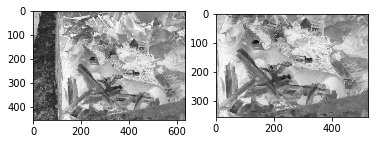





26 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
27 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
28 	                                         image          query  label  startX  \
466  c6b67f74-679a-11e5-9696-40f2e96c8ad8.jpg  medical waste    1.0    94.0   

     startY   endX   endY  
466     2.0  221.0  166.0  
Success 10


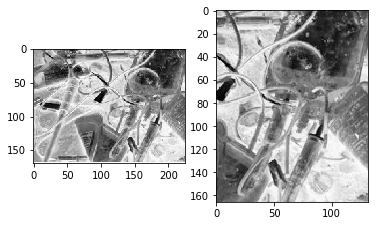





INNER LOOP 12 


0 	                                         image        query  label  startX  \
484  0d1e4d2c-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0    19.0   

     startY   endX   endY  
484    21.0  196.0  140.0  
Success 1


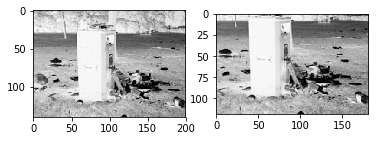





1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	                                         image        query  label  startX  \
487  10bab5d8-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0    56.0   

     startY    endX    endY  
487   387.0  1433.0  1022.0  
Success 2


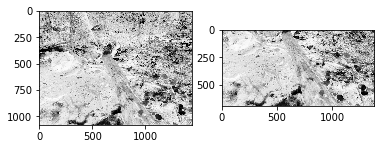





4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	                                         image        query  label  startX  \
489  14e62944-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0   159.0   

     startY   endX   endY  
489   439.0  428.0  595.0  
Success 3


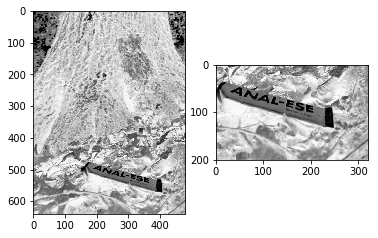





6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	                                         image        query  label  startX  \
496  1cbeb5fa-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0   195.0   

     startY   endX   endY  
496   181.0  729.0  519.0  
Success 4


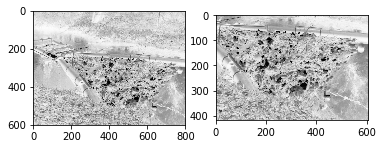





13 	                                         image        query  label  startX  \
497  2147c652-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0    99.0   

     startY   endX   endY  
497   104.0  265.0  194.0  
Success 5


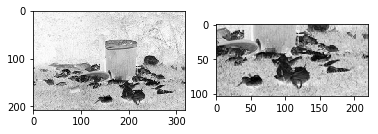





14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	                                         image        query  label  startX  \
500  2368445c-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0   101.0   

     startY   endX   endY  
500    90.0  576.0  447.0  
Success 6


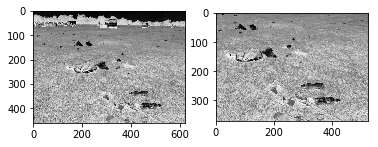





17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
22 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
23 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
24 	                                         image        query  label  startX  \
508  2ec889ce-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0     0.0   

     startY   endX   endY  
508     3.0  640.0  435.0  
Success 7


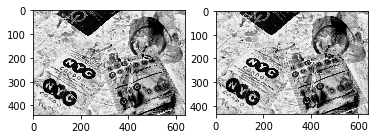





25 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
26 	                                         image        query  label  startX  \
510  2f7ea61e-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0   666.0   

     startY    endX   endY  
510   267.0  1220.0  967.0  
Success 8


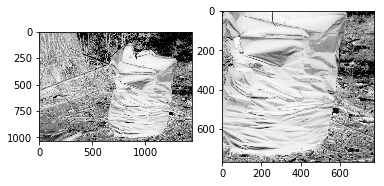





27 	                                         image        query  label  startX  \
511  2ff27346-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0   107.0   

     startY   endX   endY  
511   320.0  960.0  720.0  
Success 9


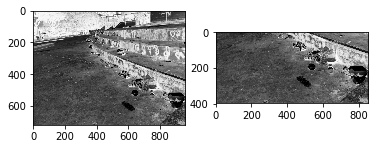





28 	                                         image        query  label  startX  \
512  307660b6-679e-11e5-8121-40f2e96c8ad8.jpg  park litter    1.0   533.0   

     startY    endX    endY  
512   141.0  1337.0  1029.0  
Success 10


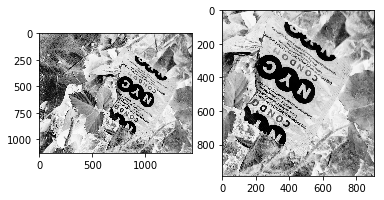





INNER LOOP 13 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	                                         image           query  label  startX  \
539  18316f92-67a2-11e5-b0b2-40f2e96c8ad8.jpg  railway garbag    1.0     3.0   

     startY  

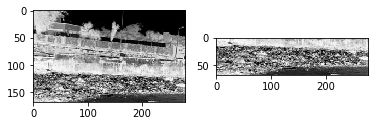





10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	 E

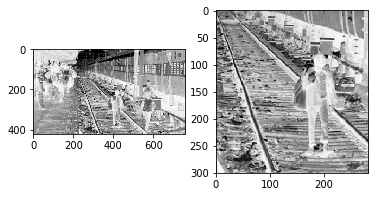





27 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
28 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
29 	                                         image           query  label  startX  \
559  e819a0d6-67a1-11e5-b0b2-40f2e96c8ad8.jpg  railway garbag    1.0    76.0   

     startY   endX   endY  
559   220.0  384.0  289.0  
Success 3


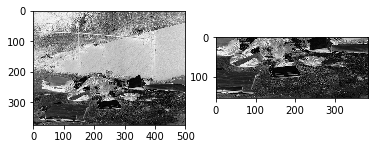





30 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
31 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
32 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
33 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
34 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
35 	                                         image           query  label  startX  \
565  eddf56dc-67a1-11e5-b0b2-40f2e96c8ad8.jpg  railway garbag    1.0    69.0   

     startY    endX   endY  
565   299.0  1185.0  885.0  
Success 4


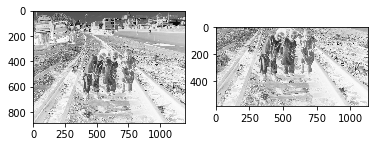





36 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
37 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
38 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
39 	                                         image           query  label  startX  \
569  f2d5cf54-67a1-11e5-b0b2-40f2e96c8ad8.jpg  railway garbag    1.0    23.0   

     startY   endX   endY  
569    70.0  631.0  342.0  
Success 5


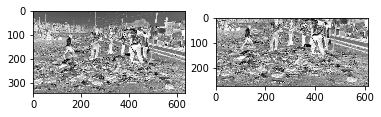





40 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
41 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
42 	                                         image           query  label  startX  \
572  fcd92d2a-67a1-11e5-b0b2-40f2e96c8ad8.jpg  railway garbag    1.0     8.0   

     startY   endX   endY  
572   100.0  300.0  172.0  
Success 6


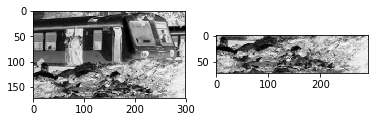





43 	                                         image           query  label  startX  \
573  fd67a08c-67a1-11e5-b0b2-40f2e96c8ad8.jpg  railway garbag    1.0    87.0   

     startY   endX   endY  
573   132.0  594.0  454.0  
Success 7


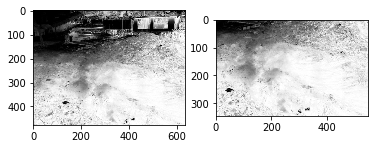





44 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
45 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
INNER LOOP 14 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	                                         image             query  label  \
577  07ff75e6-6799-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY   endX   endY  
577    26.0   177.0  481.0  399.0  
Success 1


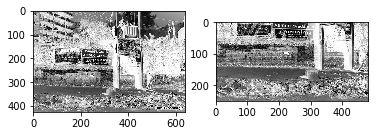





2 	                                         image             query  label  \
578  1da0cdd2-6799-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY   endX   endY  
578    56.0   124.0  346.0  223.0  
Success 2


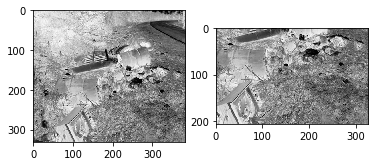





3 	                                         image             query  label  \
579  2655dada-6799-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY   endX   endY  
579    24.0    75.0  315.0  205.0  
Success 3


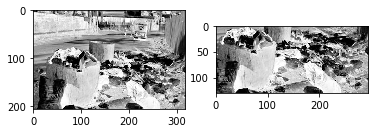





4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	                                         image             query  label  \
583  297c00ea-6799-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY   endX   endY  
583   154.0   334.0  360.0  480.0  
Success 4


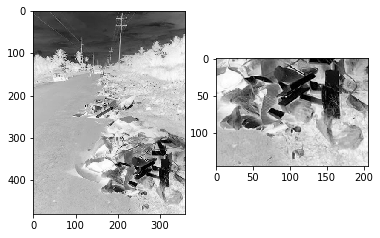





8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	                                         image             query  label  \
588  366426ac-6799-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY   endX   endY  
588    38.0    97.0  240.0  178.0  
Success 5


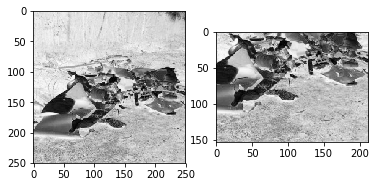





13 	                                         image             query  label  \
589  38d02dd2-6799-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY   endX   endY  
589    82.0   148.0  316.0  217.0  
Success 6


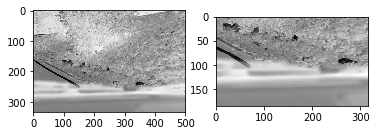





14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	                                         image             query  label  \
592  3b500736-6798-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY    endX    endY  
592   314.0   295.0  3431.0  2623.0  
Success 7


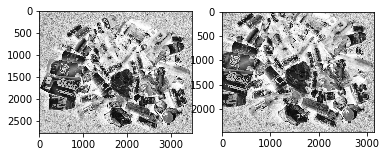





17 	                                         image             query  label  \
593  b5175740-6798-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY    endX    endY  
593  1438.0   418.0  2305.0  1938.0  
Success 8


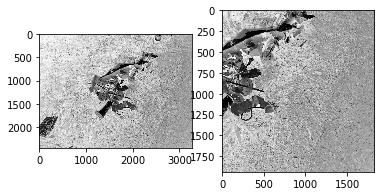





18 	                                         image             query  label  \
594  ba076ca4-6798-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY    endX   endY  
594    20.0   284.0  1080.0  715.0  
Success 9


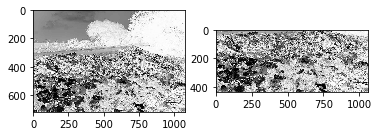





19 	                                         image             query  label  \
595  c0a5fb02-6798-11e5-8dd0-40f2e96c8ad8.jpg  roadside garbage    1.0   

     startX  startY   endX   endY  
595   140.0    96.0  470.0  237.0  
Success 10


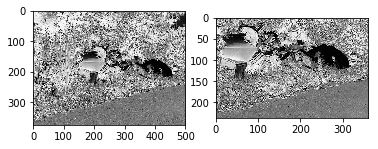





INNER LOOP 15 


0 	                                         image    query  label  startX  startY  \
619  134f5306-679b-11e5-af8c-40f2e96c8ad8.jpg  rubbish    1.0    30.0   173.0   

       endX    endY  
619  1101.0  1703.0  
Success 1


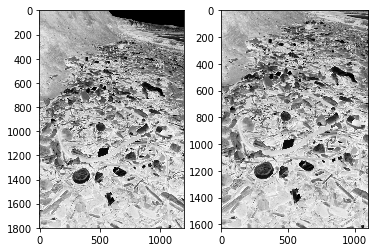





1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	                                         image    query  label  startX  startY  \
623  19aba664-679b-11e5-af8c-40f2e96c8ad8.jpg  rubbish    1.0     0.0     2.0   

      endX   endY  
623  460.0  285.0  
Success 2


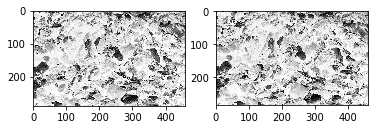





5 	                                         image    query  label  startX  startY  \
624  1be2caac-679b-11e5-af8c-40f2e96c8ad8.jpg  rubbish    1.0     3.0     3.0   

      endX   endY  
624  500.0  375.0  
Success 3


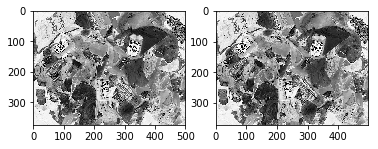





6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	                                         image    query  label  startX  startY  \
626  2067208c-679b-11e5-af8c-40f2e96c8ad8.jpg  rubbish    1.0    54.0    26.0   

      endX   endY  
626  593.0  400.0  
Success 4


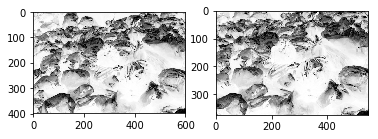





8 	                                         image    query  label  startX  startY  \
627  23382838-679b-11e5-af8c-40f2e96c8ad8.jpg  rubbish    1.0    85.0    55.0   

      endX   endY  
627  568.0  570.0  
Success 5


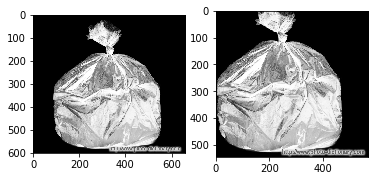





9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	                                         image    query  label  startX  startY  \
631  2af56c0c-679b-11e5-af8c-40f2e96c8ad8.jpg  rubbish    1.0    18.0   132.0   

      endX   endY  
631  468.0  293.0  
Success 6


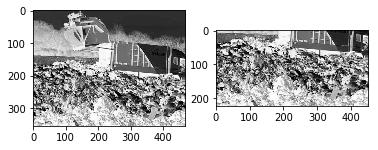





13 	                                         image    query  label  startX  startY  \
632  2da41354-679b-11e5-af8c-40f2e96c8ad8.jpg  rubbish    1.0    45.0   157.0   

      endX   endY  
632  355.0  268.0  
Success 7


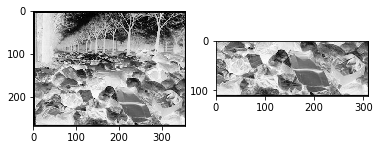





14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	                                         image    query  label  startX  startY  \
639  3ae378ca-679b-11e5-af8c-40f2e96c8ad8.jpg  rubbish    1.0    30.0   104.0   

      endX   endY  
639  597.0  325.0  
Success 8


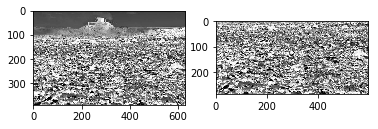





21 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
22 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
23 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
24 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
25 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
26 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
27 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
28 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
29 	                                         image    query  label  startX  startY  \
648  4c147cde-679b-11e5-af8c-40f2e96c8ad8.JPG  rubbish    1.0    62.0   426.0   

       endX   endY  
648  1048.0  960.0  
Success 9


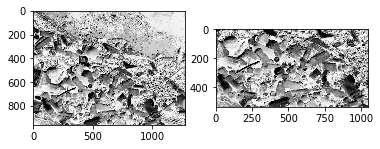





30 	                                         image    query  label  startX  startY  \
649  4c4b329c-679b-11e5-af8c-40f2e96c8ad8.jpg  rubbish    1.0    27.0   195.0   

      endX   endY  
649  629.0  507.0  
Success 10


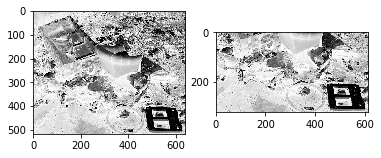





INNER LOOP 16 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	                                         image           query  label  startX  \
676  1a347966-67a1-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   140.0   

     startY   endX   endY  
676   380.0  417.0  665.0  
Success 1


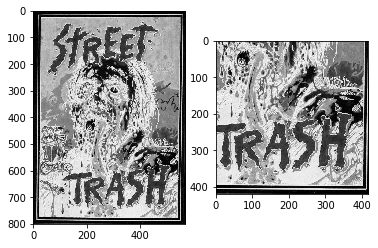





9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	                                         image           query  label  startX  \
681  32ad0828-67a1-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   151.0   

     startY   endX   endY  
681    65.0  616.0  477.0  
Success 2


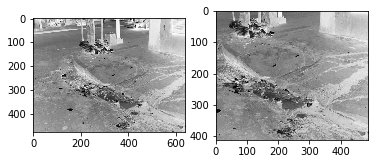





14 	                                         image           query  label  startX  \
682  3305e9de-67a1-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   141.0   

     startY   endX   endY  
682   152.0  579.0  505.0  
Success 3


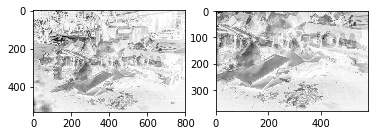





15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
22 	                                         image           query  label  startX  \
690  5167fe44-67a1-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   192.0   

     startY   endX   endY  
690   138.0  487.0  380.0  
Success 4


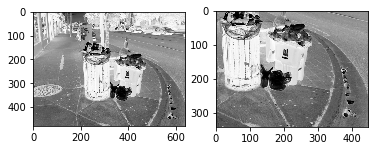





23 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
24 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
25 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
26 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
27 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
28 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
29 	                                         image           query  label  startX  \
697  b900043a-67a0-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   365.0   

     startY   endX   endY  
697   453.0  998.0  692.0  
Success 5


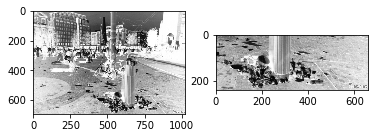





30 	                                         image           query  label  startX  \
698  bd624f24-67a0-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   363.0   

     startY   endX   endY  
698   310.0  900.0  600.0  
Success 6


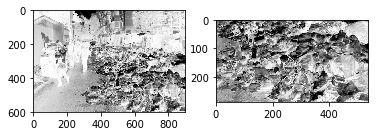





31 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
32 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
33 	                                         image           query  label  startX  \
701  cc96c98e-67a0-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   295.0   

     startY   endX   endY  
701   331.0  633.0  510.0  
Success 7


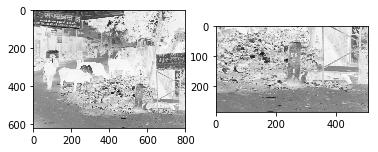





34 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
35 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
36 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
37 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
38 	                                         image           query  label  startX  \
706  e8887d18-67a0-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   126.0   

     startY    endX   endY  
706   431.0  1209.0  762.0  
Success 8


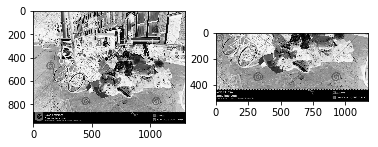





39 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
40 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
41 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
42 	                                         image           query  label  startX  \
710  f01435ae-67a0-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   790.0   

     startY    endX    endY  
710   356.0  1673.0  1908.0  
Success 9


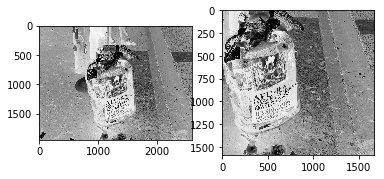





43 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
44 	                                         image           query  label  startX  \
712  f3905e74-67a0-11e5-a5ed-40f2e96c8ad8.jpg  street garbage    1.0   947.0   

     startY    endX    endY  
712   817.0  3219.0  2144.0  
Success 10


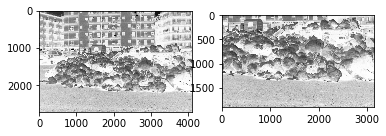





INNER LOOP 17 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	                                         image          query  label  startX  \
716  071ddf2e-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0    87.0   

     startY   endX   endY  
716    10.0  435.0  265.0  
Success 1


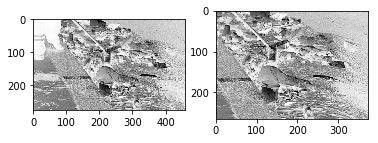





2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	                                         image          query  label  startX  \
718  09db550c-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0   430.0   

     startY    endX    endY  
718  1510.0  3478.0  3451.0  
Success 2


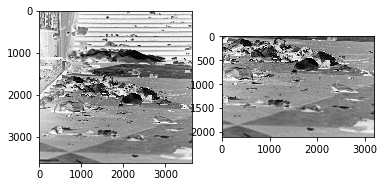





4 	                                         image          query  label  startX  \
719  3943d558-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0    52.0   

     startY   endX   endY  
719    72.0  187.0  176.0  
Success 3


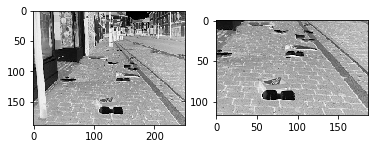





5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	                                         image          query  label  startX  \
722  3fc8a174-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0    25.0   

     startY   endX    endY  
722   284.0  549.0  1048.0  
Success 4


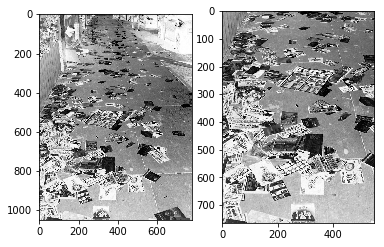





8 	                                         image          query  label  startX  \
723  4333c5be-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0     4.0   

     startY   endX   endY  
723     3.0  500.0  279.0  
Success 5


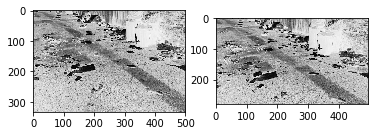





9 	                                         image          query  label  startX  \
724  47531a5a-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0   110.0   

     startY    endX   endY  
724   254.0  1600.0  993.0  
Success 6


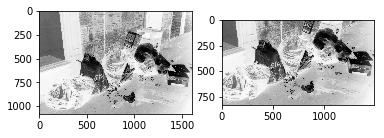





10 	                                         image          query  label  startX  \
725  4aea0dcc-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0    73.0   

     startY   endX   endY  
725   162.0  466.0  316.0  
Success 7


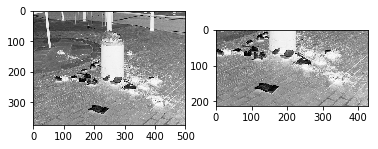





11 	                                         image          query  label  startX  \
726  4cc9d74e-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0    63.0   

     startY   endX   endY  
726   516.0  633.0  941.0  
Success 8


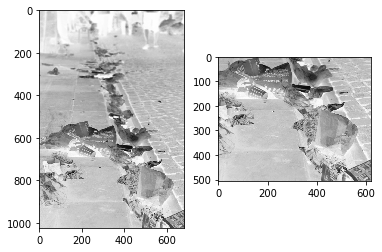





12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	                                         image          query  label  startX  \
732  5ae4e6fc-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0    26.0   

     startY   endX   endY  
732    48.0  429.0  414.0  
Success 9


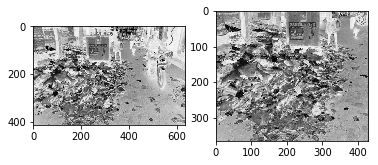





18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	                                         image          query  label  startX  \
734  5da02816-679d-11e5-90f4-40f2e96c8ad8.jpg  street litter    1.0   214.0   

     startY   endX   endY  
734   147.0  344.0  413.0  
Success 10


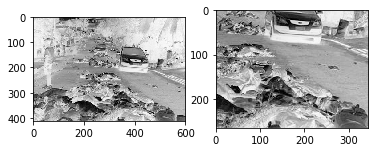





INNER LOOP 18 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	                                         image  query  label  startX  startY  \
763  15461d1a-679c-11e5-a533-40f2e96c8ad8.JPG  trash    1.0   334.0   515.0   

       endX    endY  
763  1485.0  1073.0  
Success 1


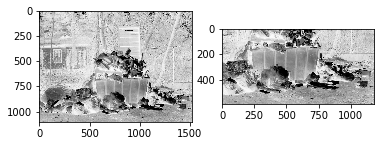





2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	                                         image  query  label  startX  startY  \
766  1b3085e4-679c-11e5-a533-40f2e96c8ad8.jpg  trash    1.0    27.0    84.0   

      endX   endY  
766  287.0  224.0  
Success 2


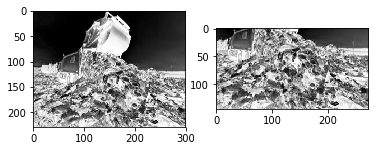





5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	                                         image  query  label  startX  startY  \
769  25fbaf4e-679c-11e5-a533-40f2e96c8ad8.jpg  trash    1.0    38.0    52.0   

      endX   endY  
769  381.0  245.0  
Success 3


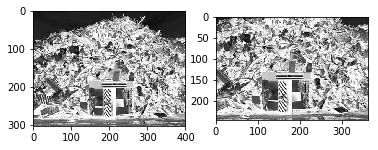





8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	                                         image  query  label  startX  startY  \
772  2c33b546-679c-11e5-a533-40f2e96c8ad8.jpg  trash    1.0    14.0    71.0   

      endX   endY  
772  261.0  182.0  
Success 4


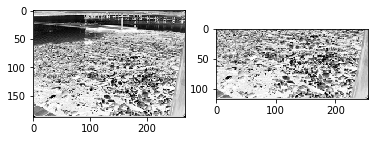





11 	                                         image  query  label  startX  startY  \
773  30317fc0-679c-11e5-a533-40f2e96c8ad8.jpg  trash    1.0     3.0   159.0   

      endX   endY  
773  436.0  328.0  
Success 5


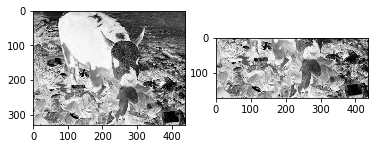





12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	                                         image  query  label  startX  startY  \
775  31e26370-679c-11e5-a533-40f2e96c8ad8.jpg  trash    1.0     2.0     3.0   

      endX   endY  
775  499.0  326.0  
Success 6


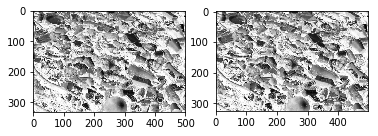





14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	                                         image  query  label  startX  startY  \
777  34eb7e62-679c-11e5-a533-40f2e96c8ad8.jpg  trash    1.0    23.0    94.0   

      endX   endY  
777  593.0  393.0  
Success 7


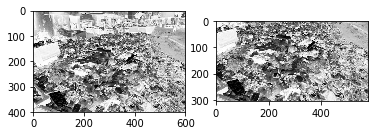





16 	                                         image  query  label  startX  startY  \
778  384ca7e8-679c-11e5-a533-40f2e96c8ad8.jpg  trash    1.0    68.0   101.0   

      endX   endY  
778  217.0  403.0  
Success 8


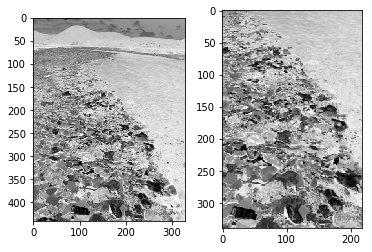





17 	                                         image  query  label  startX  startY  \
779  392bee8a-679c-11e5-a533-40f2e96c8ad8.jpg  trash    1.0   126.0    22.0   

       endX    endY  
779  2163.0  1367.0  
Success 9


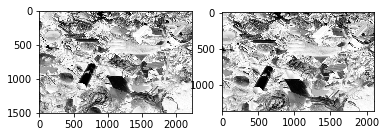





18 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	                                         image  query  label  startX  startY  \
782  8b1514c0-679b-11e5-a533-40f2e96c8ad8.jpg  trash    1.0   272.0   358.0   

       endX   endY  
782  1119.0  764.0  
Success 10


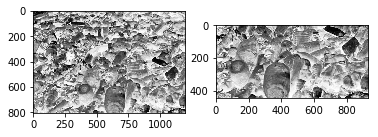





INNER LOOP 19 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	                                         image           query  label  startX  \
814  792f9e6c-679e-11e5-b0d3-40f2e96c8ad8.jpg  trash on roads    1.0   153.0   

     startY   endX   endY  
814    68.0  440.0  353.0  
Success 1


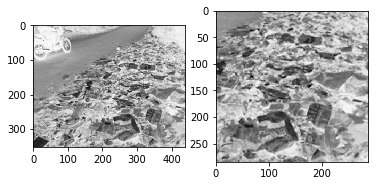





4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	                                         image           query  label  startX  \
816  7e658be4-679e-11e5-b0d3-40f2e96c8ad8.jpg  trash on roads    1.0   148.0   

     startY    endX   endY  
816   222.0  1300.0  878.0  
Success 2


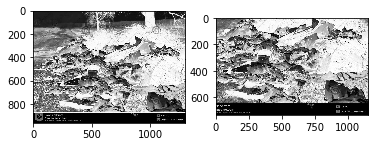





6 	                                         image           query  label  startX  \
817  80bfceae-679e-11e5-b0d3-40f2e96c8ad8.png  trash on roads    1.0    30.0   

     startY    endX    endY  
817   240.0  1578.0  1039.0  
Success 3


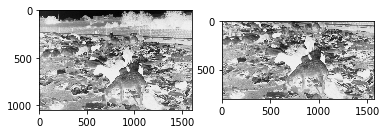





7 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
8 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	                                         image           query  label  startX  \
821  826e000e-679e-11e5-b0d3-40f2e96c8ad8.jpg  trash on roads    1.0     2.0   

     startY   endX   endY  
821     0.0  619.0  417.0  
Success 4


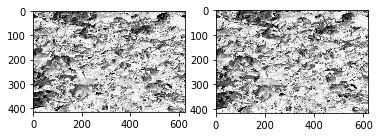





11 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
12 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
13 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	                                         image           query  label  startX  \
826  8b245de2-679e-11e5-b0d3-40f2e96c8ad8.jpg  trash on roads    1.0    16.0   

     startY   endX   endY  
826   171.0  598.0  402.0  
Success 5


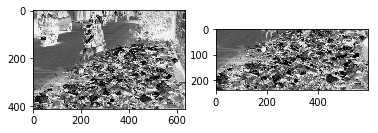





16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
18 	                                         image           query  label  startX  \
829  9117d378-679e-11e5-b0d3-40f2e96c8ad8.jpg  trash on roads    1.0  1040.0   

     startY    endX    endY  
829  1346.0  1994.0  1913.0  
Success 6


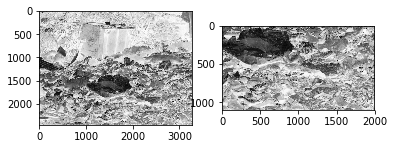





19 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	                                         image           query  label  startX  \
832  99cf372c-679e-11e5-b0d3-40f2e96c8ad8.jpg  trash on roads    1.0    91.0   

     startY   endX   endY  
832    70.0  392.0  225.0  
Success 7


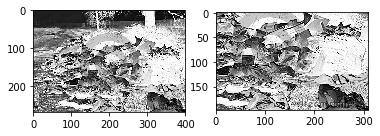





22 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
23 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
24 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
25 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
26 	                                         image           query  label  startX  \
837  a1cc13b4-679e-11e5-b0d3-40f2e96c8ad8.jpg  trash on roads    1.0   233.0   

     startY   endX   endY  
837   240.0  592.0  380.0  
Success 8


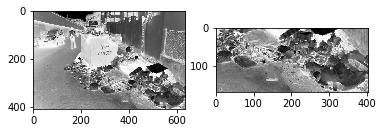





27 	                                         image           query  label  startX  \
838  a210c932-679e-11e5-b0d3-40f2e96c8ad8.jpg  trash on roads    1.0   111.0   

     startY   endX   endY  
838    79.0  262.0  192.0  
Success 9


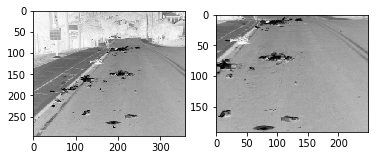





28 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
29 	                                         image           query  label  startX  \
840  a4c86fb8-679e-11e5-b0d3-40f2e96c8ad8.jpg  trash on roads    1.0   105.0   

     startY   endX   endY  
840   162.0  626.0  448.0  
Success 10


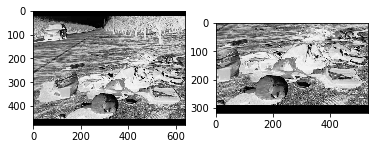





INNER LOOP 20 


0 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
1 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
2 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
3 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
4 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
5 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
6 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
7 	                                         image  query  label  startX  startY  \
867  1c876148-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0    26.0   170.0   

      endX   endY  
867  592.0  443.0  
Success 1


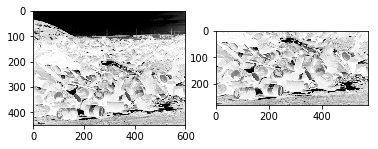





8 	                                         image  query  label  startX  startY  \
868  1e183230-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0     4.0     8.0   

       endX    endY  
868  2560.0  1920.0  
Success 2


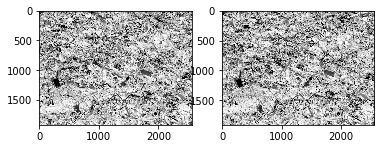





9 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
10 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
11 	                                         image  query  label  startX  startY  \
871  3a0f2156-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0    63.0  1260.0   

       endX    endY  
871  3500.0  2690.0  
Success 3


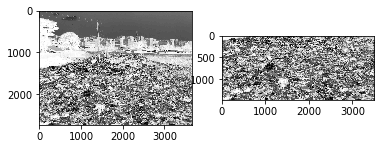





12 	                                         image  query  label  startX  startY  \
872  3bf77554-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0   166.0   382.0   

      endX   endY  
872  922.0  675.0  
Success 4


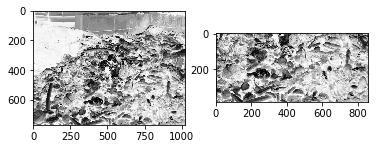





13 	                                         image  query  label  startX  startY  \
873  416d45f4-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0     5.0   131.0   

      endX   endY  
873  228.0  216.0  
Success 5


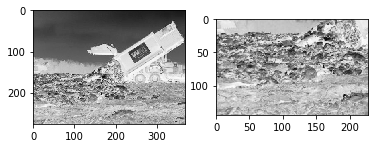





14 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
15 	                                         image  query  label  startX  startY  \
875  421dc3c0-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0    47.0   181.0   

      endX   endY  
875  606.0  399.0  
Success 6


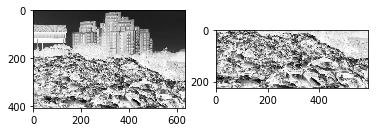





16 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
17 	                                         image  query  label  startX  startY  \
877  4496ea3c-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0    26.0   136.0   

      endX   endY  
877  417.0  344.0  
Success 7


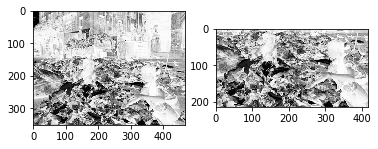





18 	                                         image  query  label  startX  startY  \
878  51c09ea6-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0    28.0   130.0   

      endX   endY  
878  370.0  280.0  
Success 8


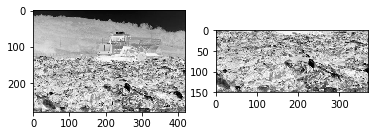





19 	                                         image  query  label  startX  startY  \
879  52a1889e-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0     7.0     4.0   

      endX   endY  
879  626.0  450.0  
Success 9


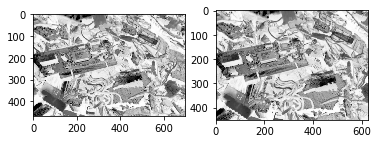





20 	 Empty DataFrame
Columns: [image, query, label, startX, startY, endX, endY]
Index: []
21 	                                         image  query  label  startX  startY  \
881  5802c9ce-67a0-11e5-89b3-40f2e96c8ad8.jpg  waste    1.0     1.0     2.0   

      endX   endY  
881  345.0  273.0  
Success 10


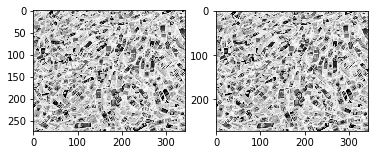





OUTER LOOP  2 


INNER LOOP 21 


Success 0


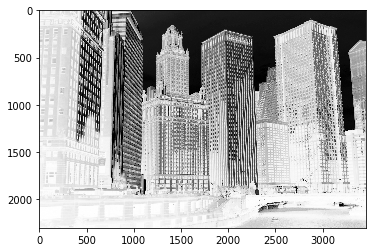





Success 1


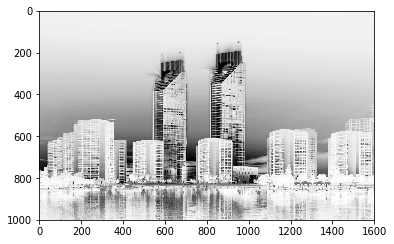





Success 2


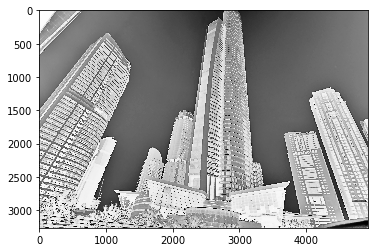





Success 3


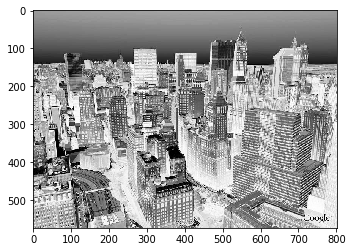





Success 4


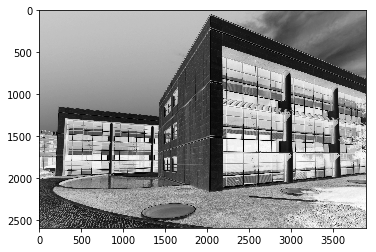





Success 5


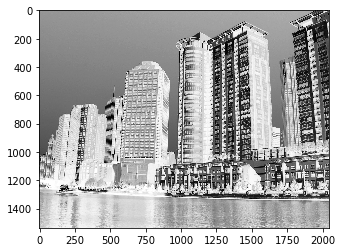





Success 6


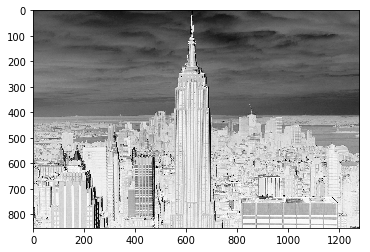





Success 7


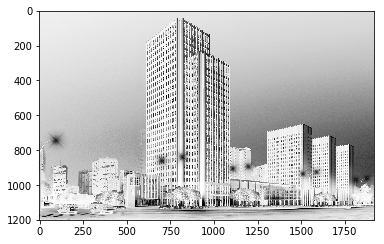





Success 8


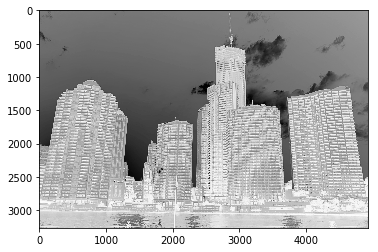





Success 9
INNER LOOP 22 


Success 0


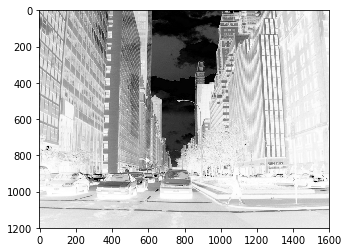





Success 1


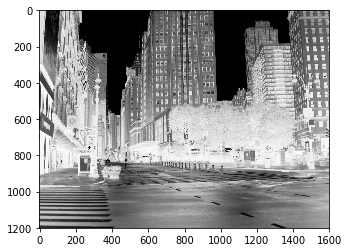





Success 2


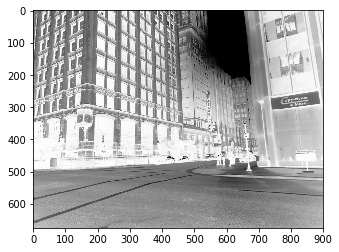





Success 3


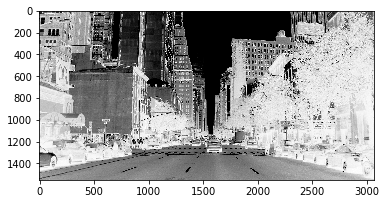





Success 4


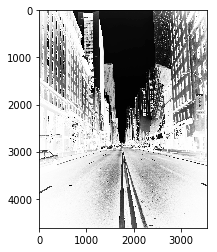





Success 5


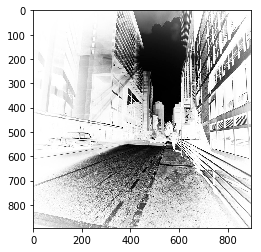





Success 6


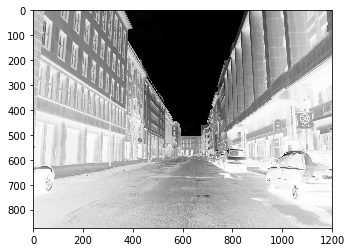





Success 7


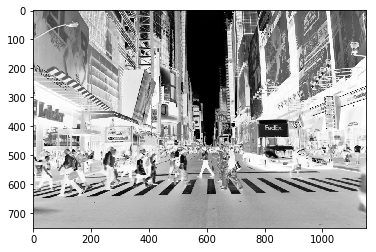





Success 8


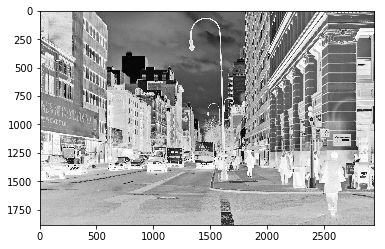





Success 9
INNER LOOP 23 


Success 0


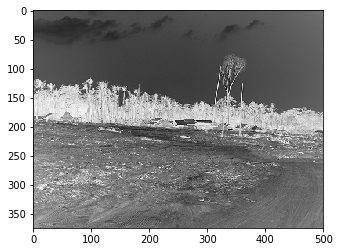





Success 1


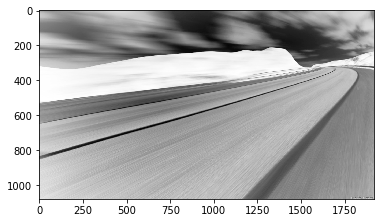





Success 2


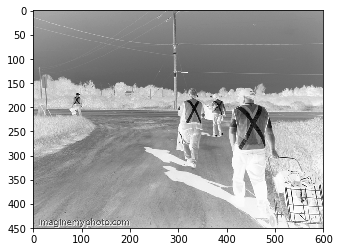





Success 3


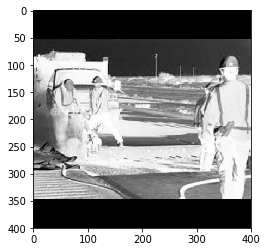





Success 4


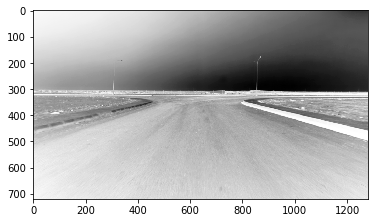





Success 5


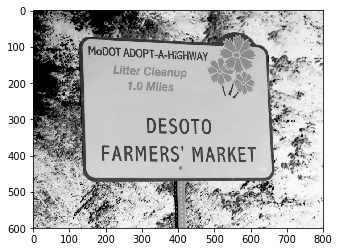





Success 6


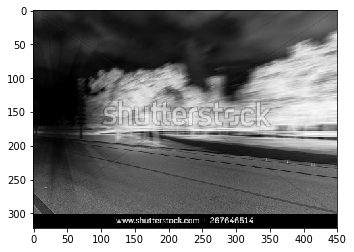





Success 7


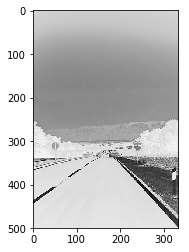





Success 8


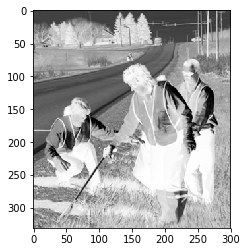





Success 9
INNER LOOP 24 


Success 0


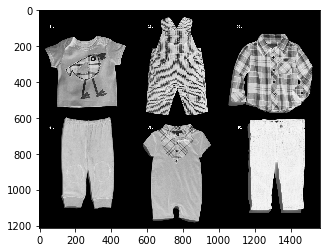





Success 1


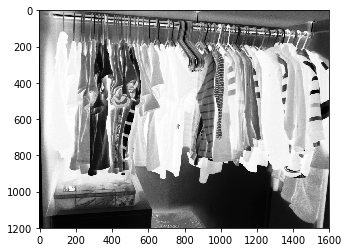





Success 2


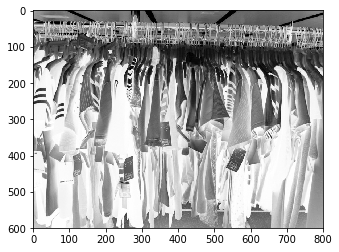





Success 3


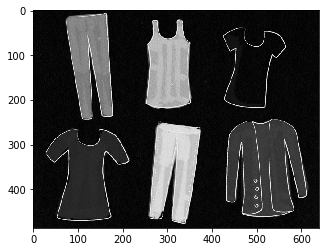





Success 4


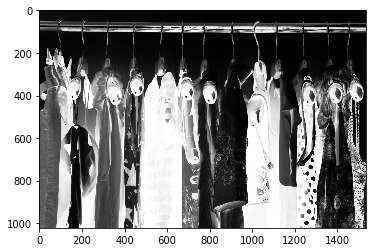





Success 5


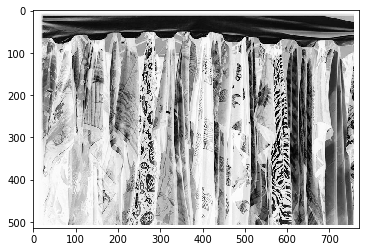





Success 6


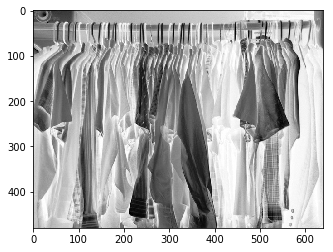





Success 7


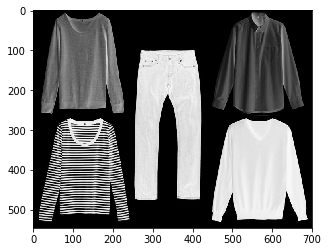





Success 8


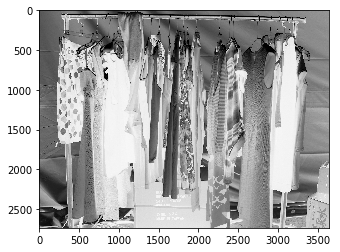





Success 9
INNER LOOP 25 


Success 0


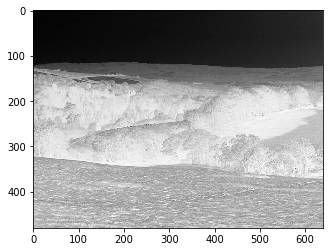





Success 1


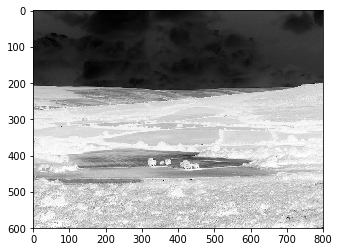





Success 2


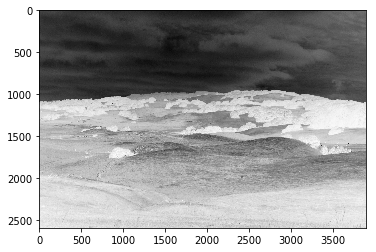





Success 3


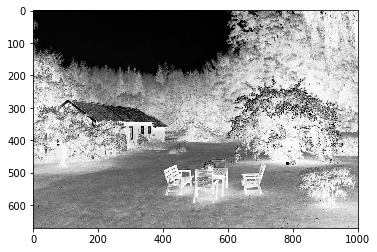





Success 4


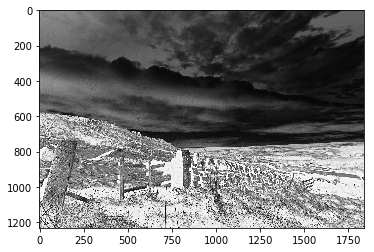





Success 5


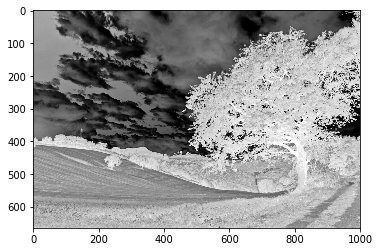





Success 6


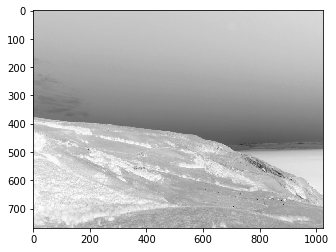





Success 7


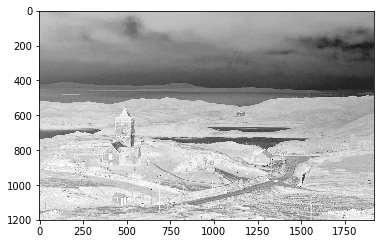





Success 8


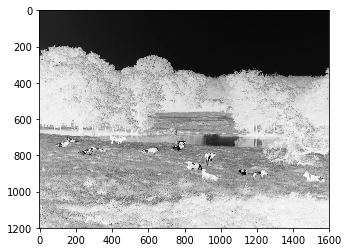





Success 9
INNER LOOP 26 


Success 0


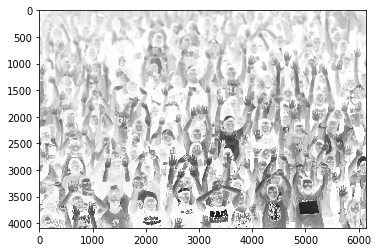





Success 1


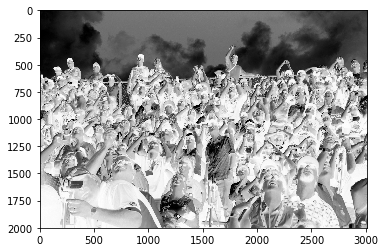





Success 2


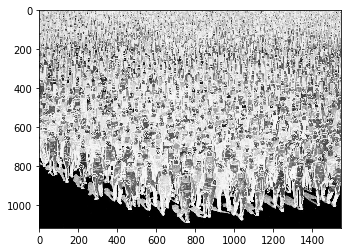





Success 3


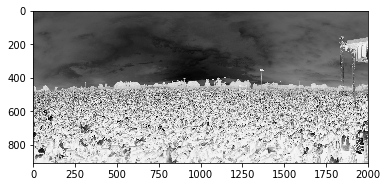





Success 4


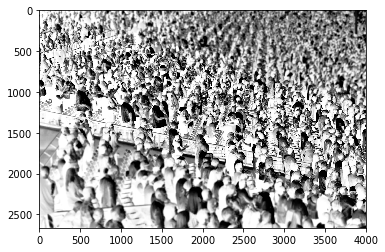





Success 5


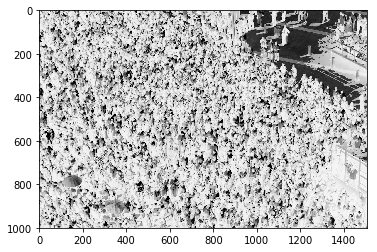





Success 6


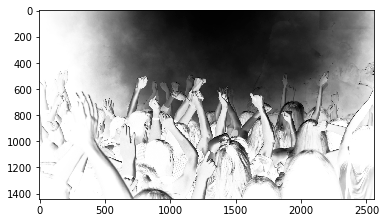





Success 7


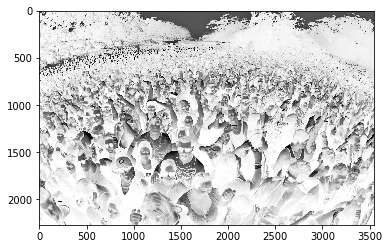





Success 8


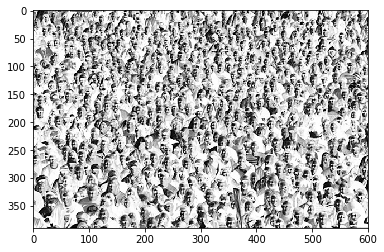





Success 9
INNER LOOP 27 


Success 0


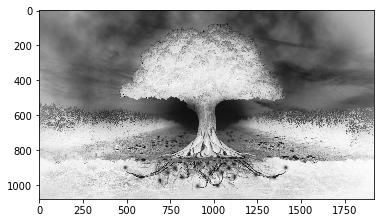





Success 1


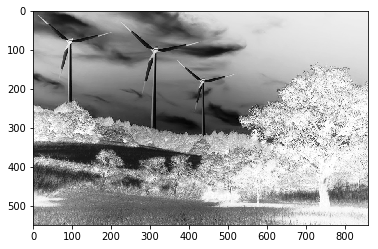





Success 2


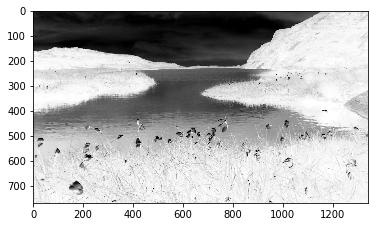





Success 3


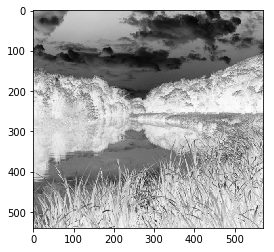





Success 4


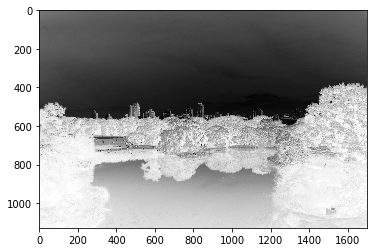





Success 5


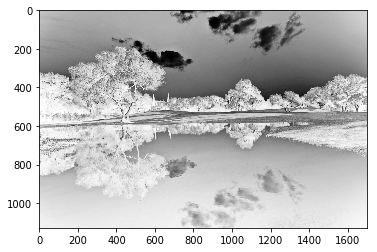





Success 6


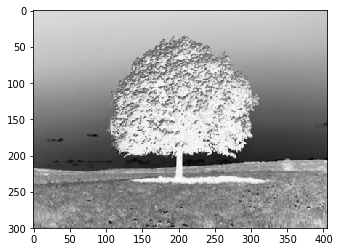





Success 7


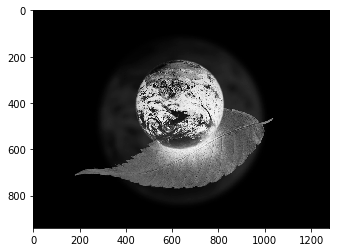





Success 8


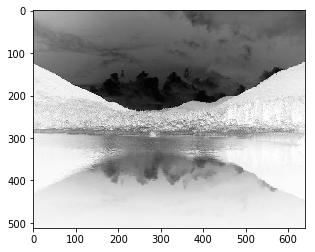





Success 9
INNER LOOP 28 


Success 0


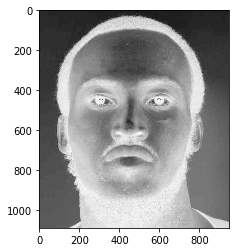





Success 1


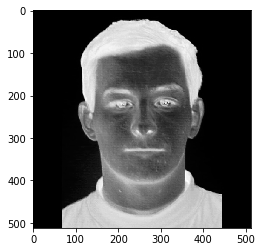





Success 2


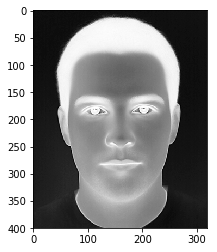





Success 3


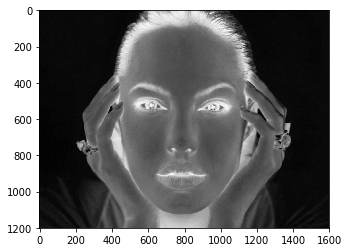





Success 4


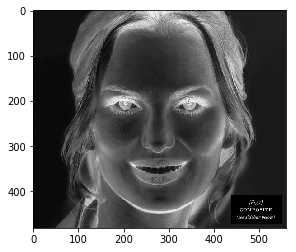





Success 5


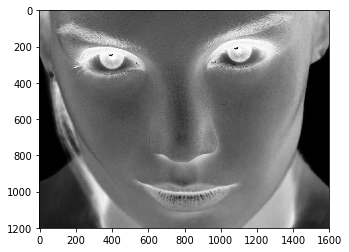





Success 6


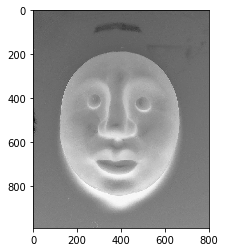





Success 7


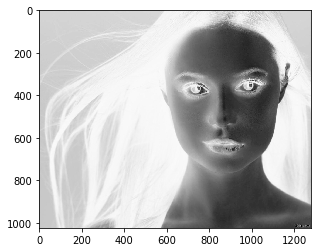





Success 8


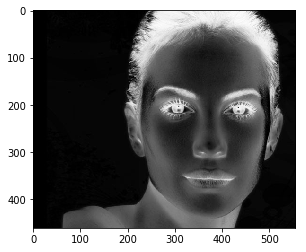





Success 9
INNER LOOP 29 


Success 0


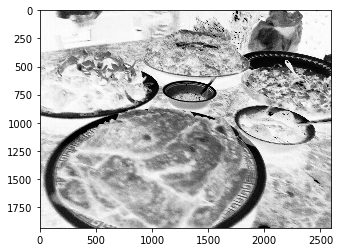





Success 1


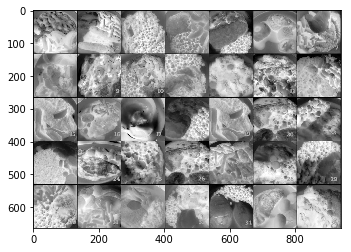





Success 2


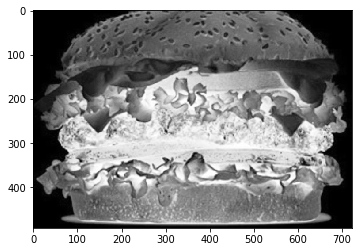





Success 3


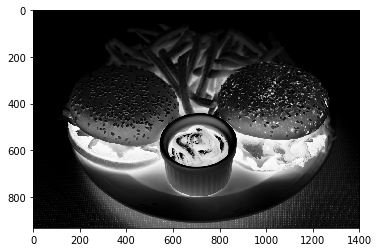





Success 4


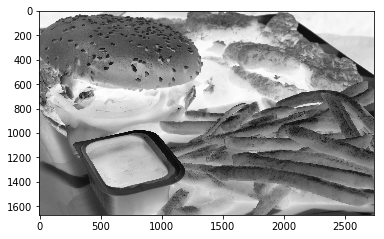





Success 5


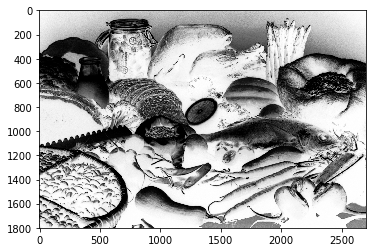





Success 6


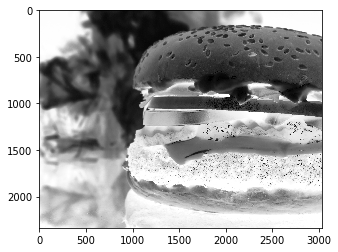





Success 7


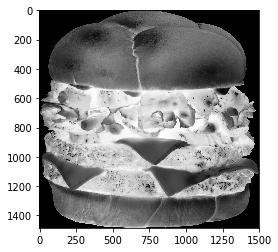





Success 8


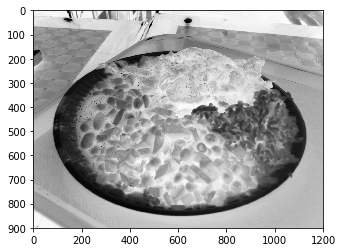





Success 9
INNER LOOP 30 


Success 0


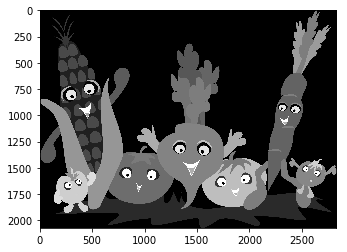





Success 1


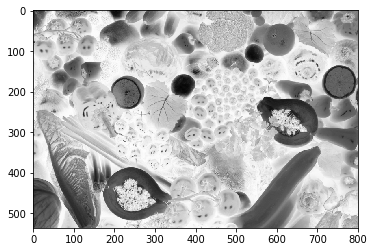





Success 2


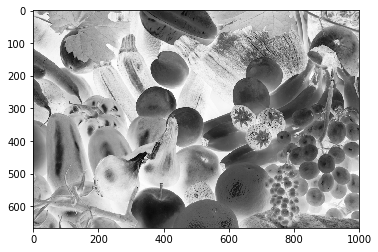





Success 3


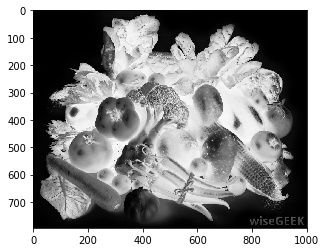





Success 4


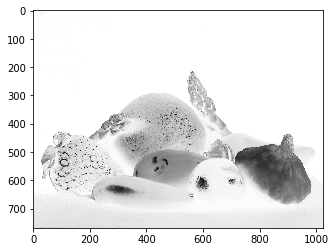





Success 5


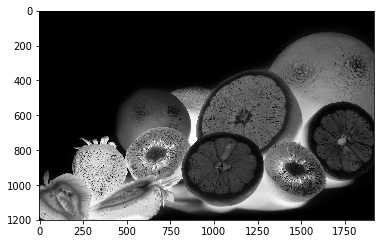





Success 6


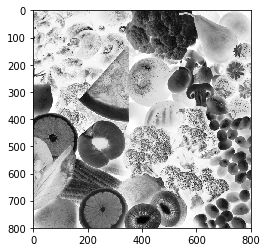





Success 7


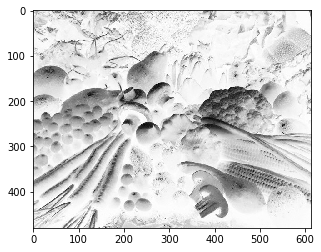





Success 8


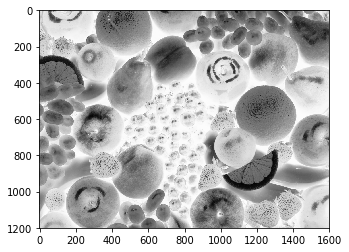





Success 9
INNER LOOP 31 


Success 0


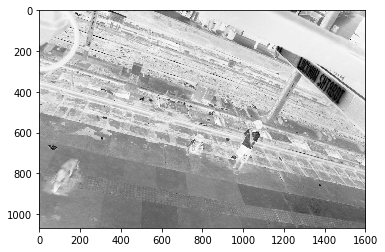





Success 1


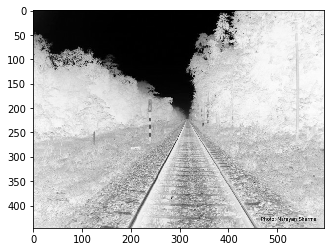





Success 2


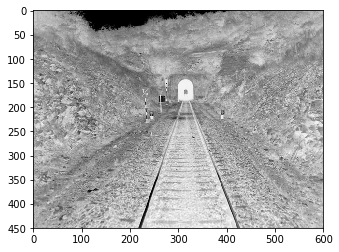





Success 3


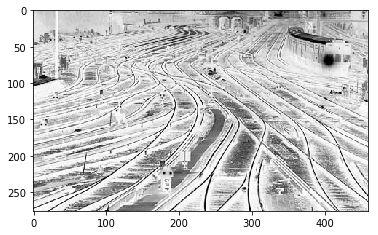





Success 4


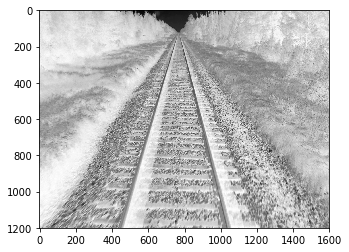





Success 5


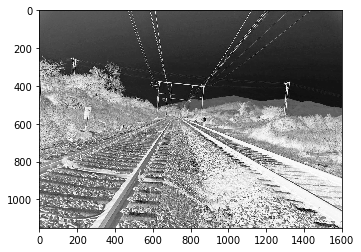





Success 6


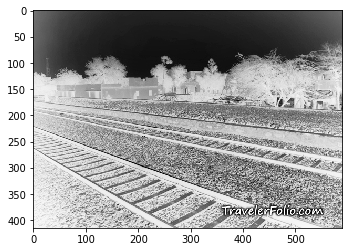





Success 7


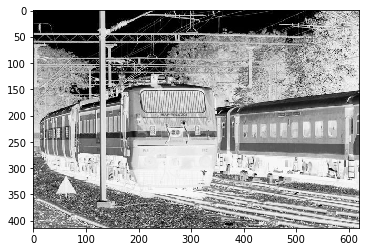





Success 8


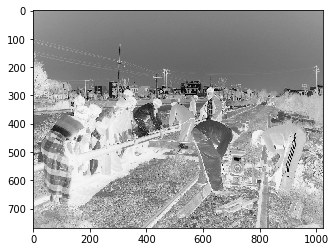





Success 9
INNER LOOP 32 


Success 0


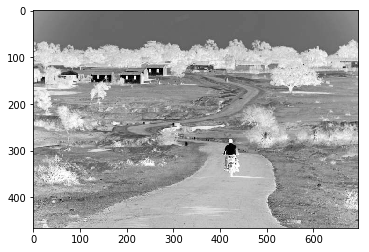





Success 1


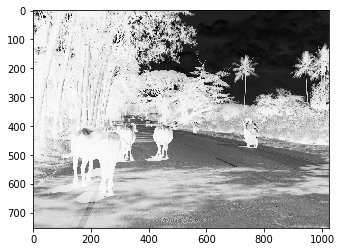





Success 2


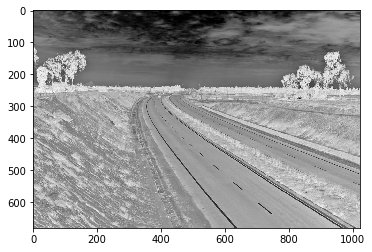





Success 3


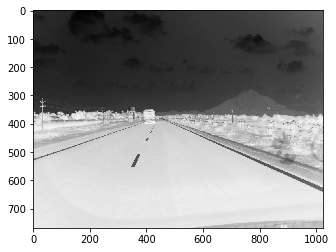





Success 4


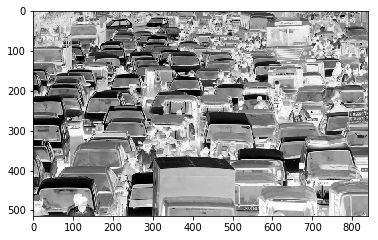





Success 5


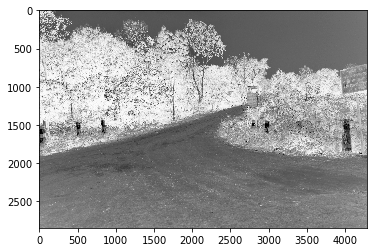





Success 6


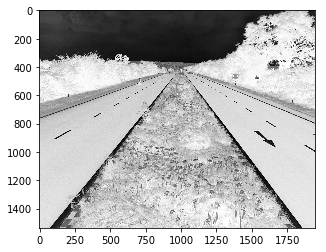





Success 7


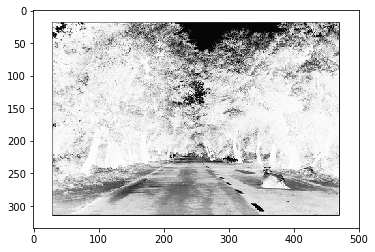





Success 8


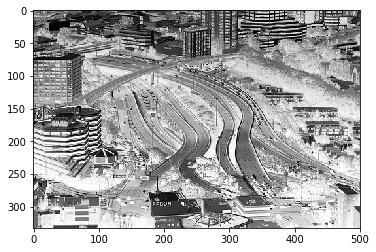





Success 9
INNER LOOP 33 


Success 0


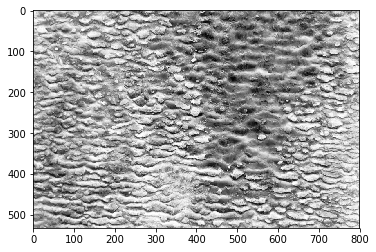





Success 1


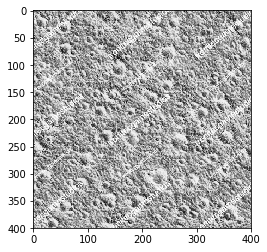





Success 2


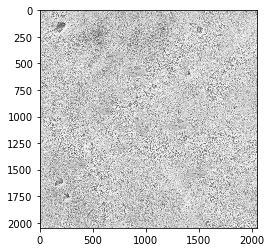





Success 3


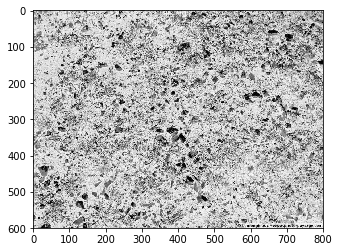





Success 4


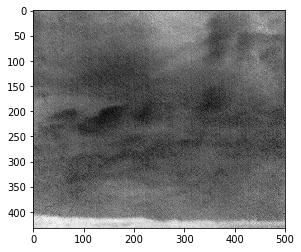





Success 5


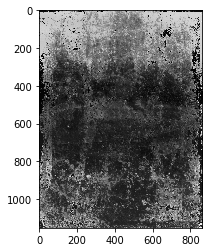





Success 6


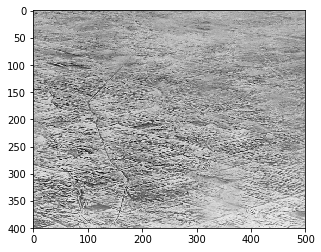





Success 7


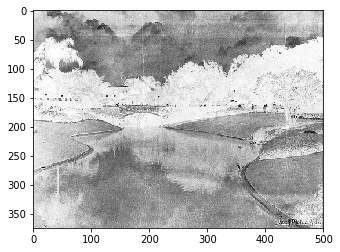





Success 8


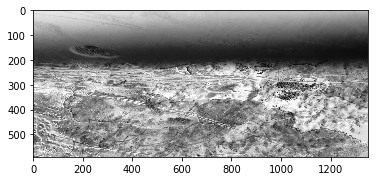





Success 9
INNER LOOP 34 


Success 0


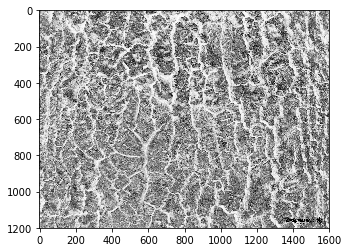





Success 1


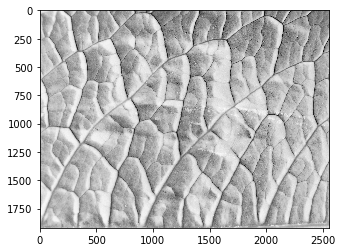





Success 2


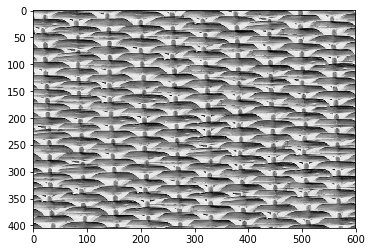





Success 3


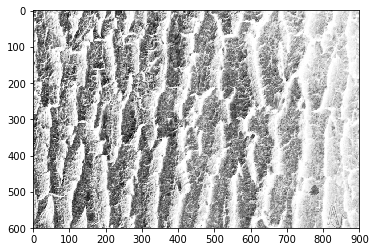





Success 4


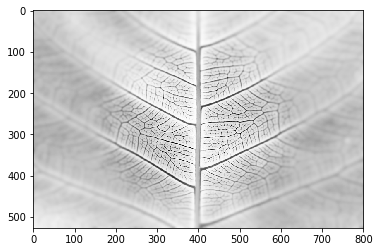





Success 5


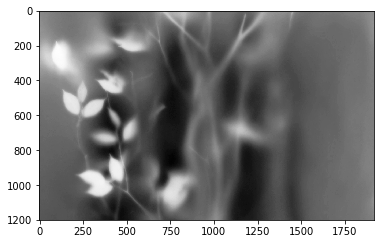





Success 6


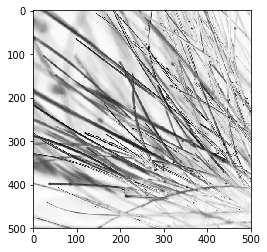





Success 7


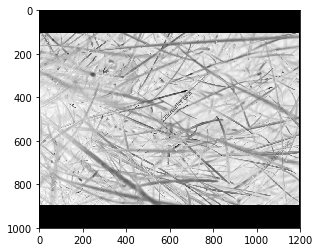





Success 8


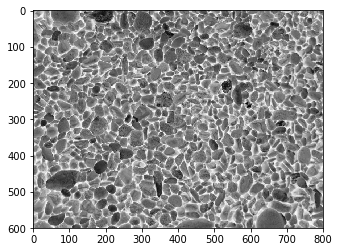





Success 9
INNER LOOP 35 


Success 0


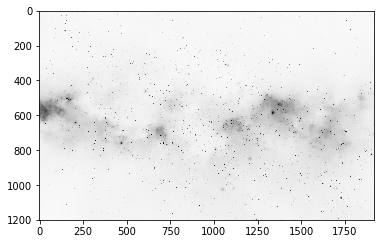





Success 1


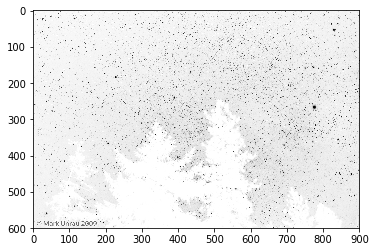





Success 2


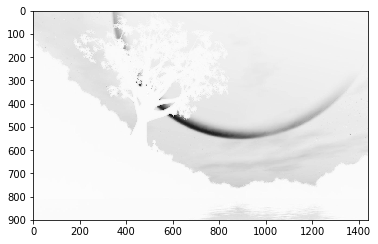





Success 3


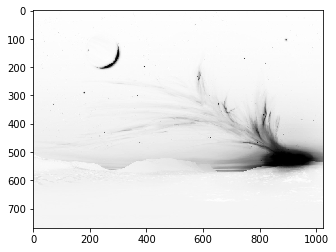





Success 4


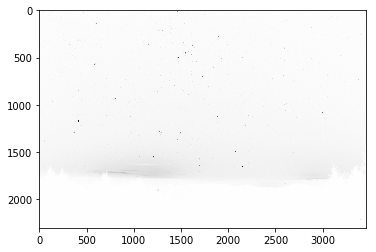





Success 5


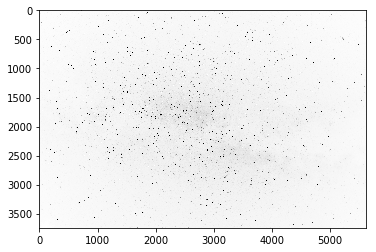





Success 6


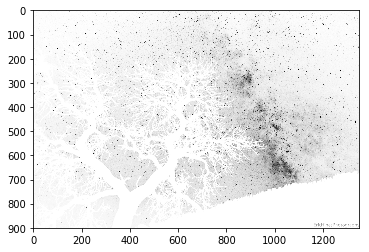





Success 7


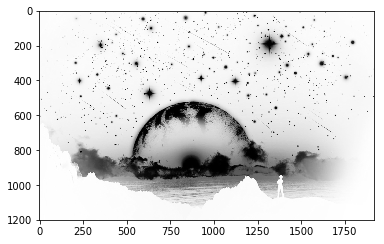





Success 8


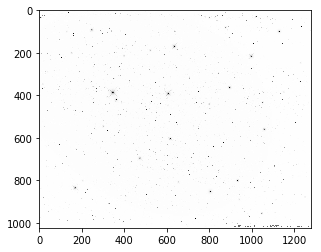





Success 9
INNER LOOP 36 


Success 0


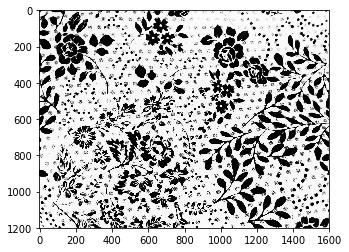





Success 1


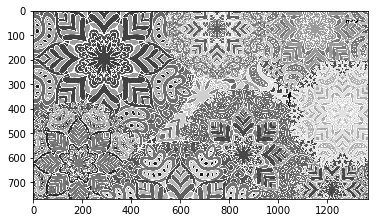





Success 2


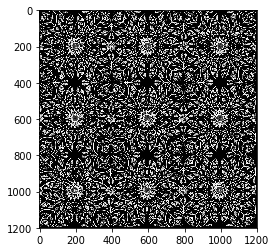





Success 3


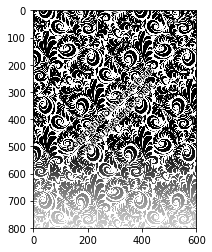





Success 4


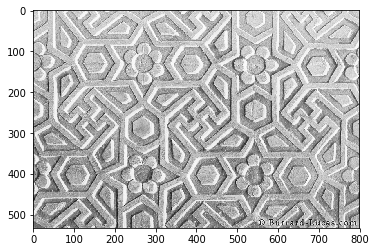





Success 5


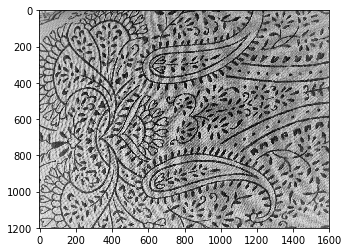





Success 6


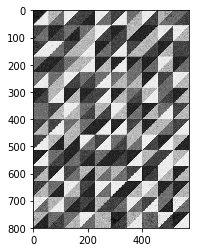





Success 7


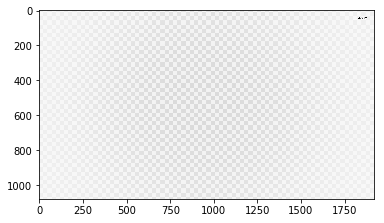





Success 8


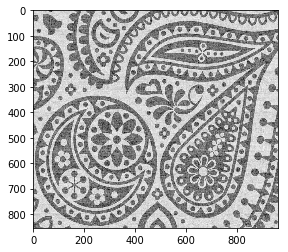





Success 9
INNER LOOP 37 


Success 0


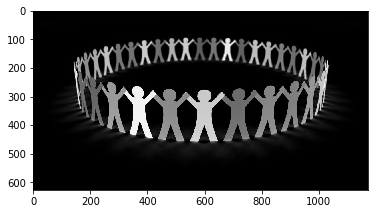





Success 1


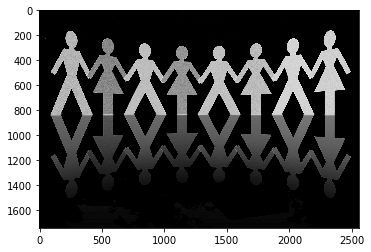





Success 2


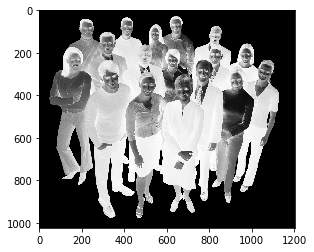





Success 3


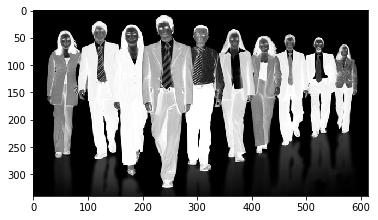





Success 4


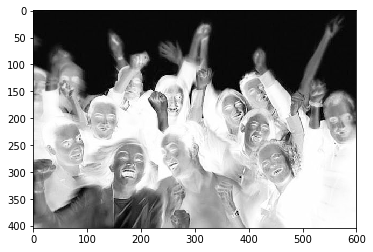





Success 5


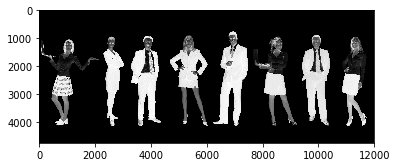





Success 6


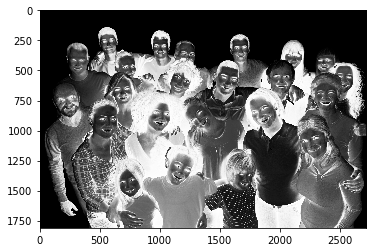





Success 7


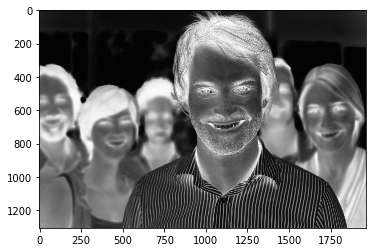





Success 8


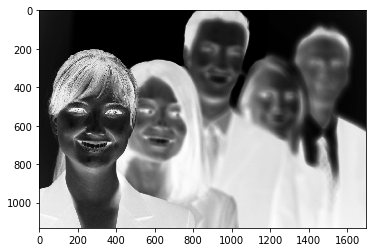





Success 9
INNER LOOP 38 


Success 0


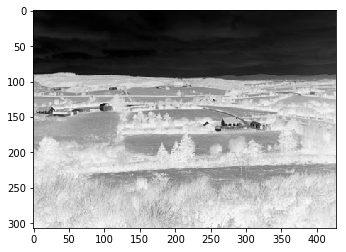





Success 1


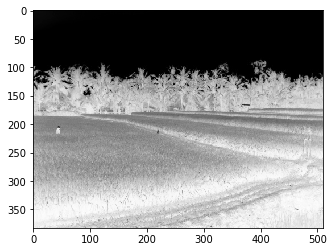





Success 2


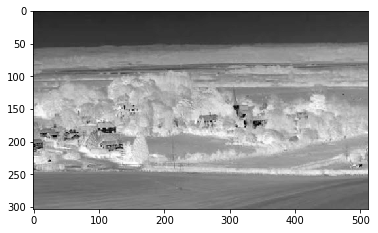





Success 3


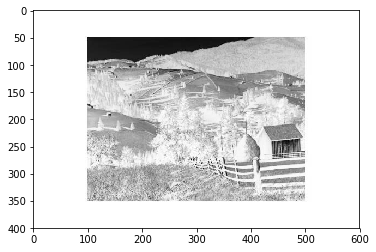





Success 4


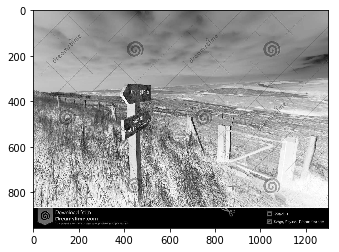





Success 5


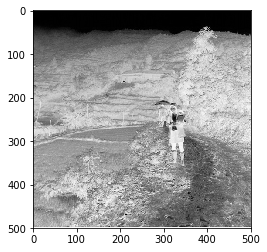





Success 6


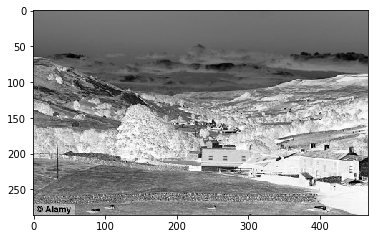





Success 7


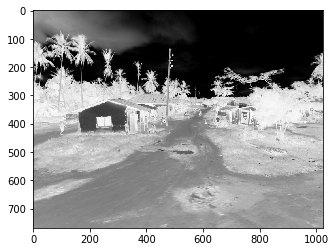





Success 8


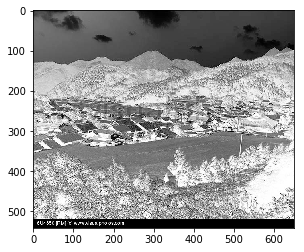





Success 9
INNER LOOP 39 


Success 0


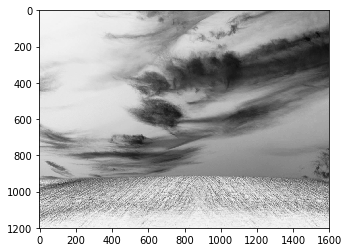





Success 1


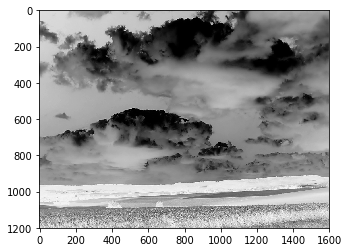





Success 2


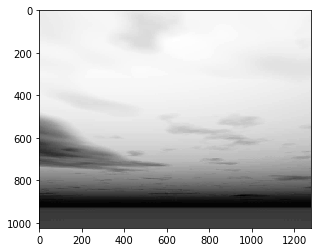





Success 3


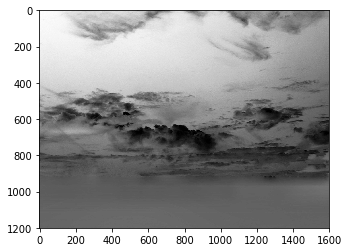





Success 4


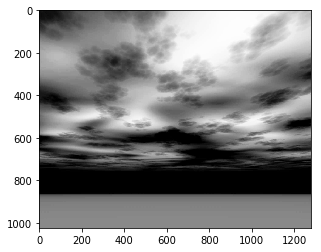





Success 5


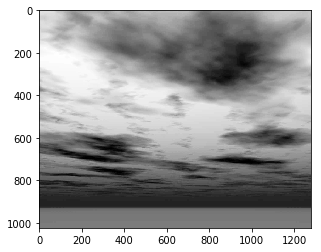





Success 6


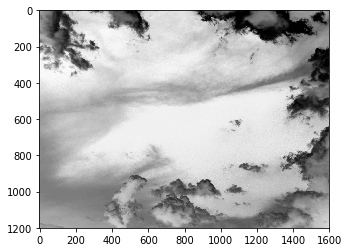





Success 7


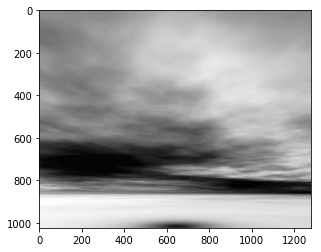





Success 8


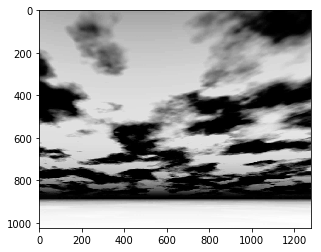





Success 9
INNER LOOP 40 


Success 0


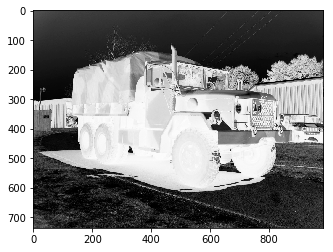





Success 1


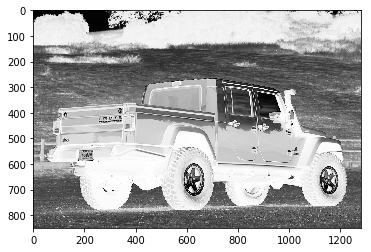





Success 2


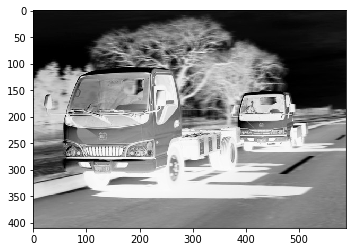





Success 3


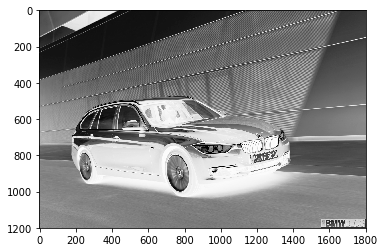





Success 4


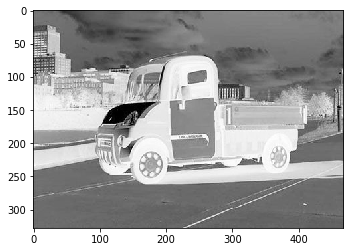





Success 5


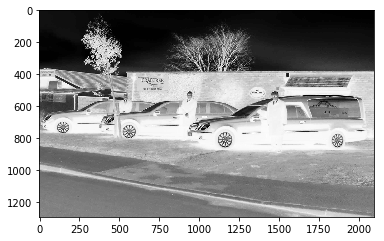





Success 6


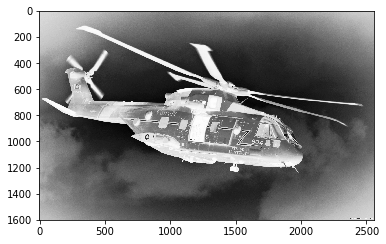





Success 7


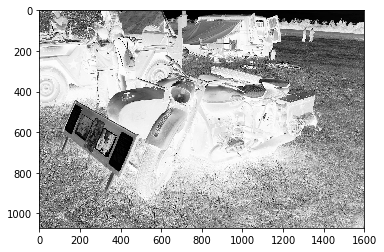





Success 8


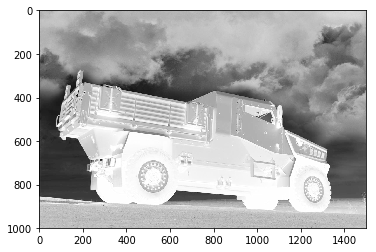





Success 9
INNER LOOP 41 


Success 0


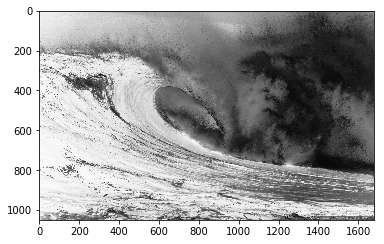





Success 1


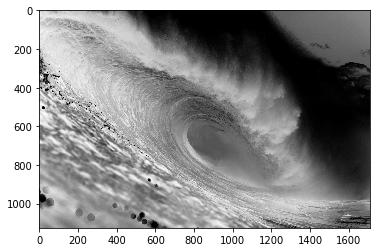





Success 2


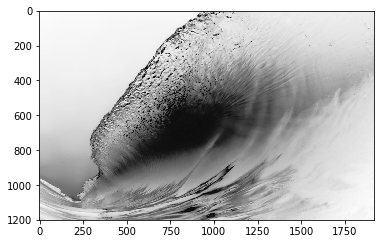





Success 3


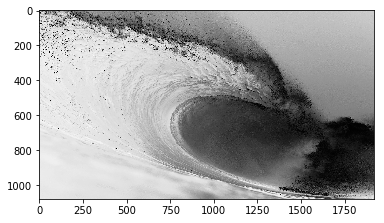





Success 4


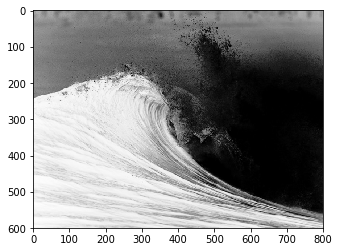





Success 5


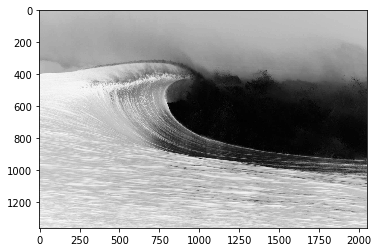





Success 6


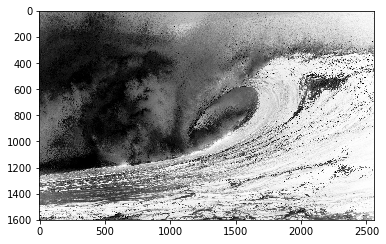





Success 7


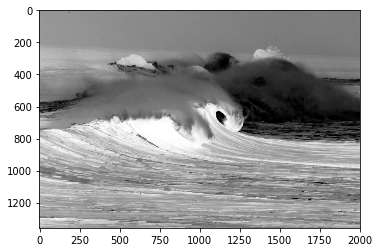





Success 8


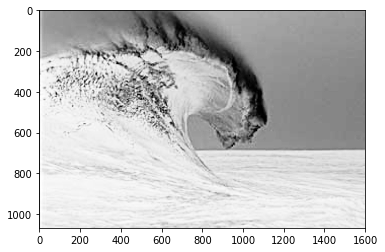





Success 9


In [212]:
%matplotlib inline

dataset = []
labels = []
success = 0
success2 = 0
outer_loop, inner_loop = 0,0
ax = plt.Figure()
window_name = 'Train Images'
for i in os.listdir(path):
    path1 = os.path.join(path,i)
    categories1 = os.listdir(path1)
    #print(path1)

    print("OUTER LOOP ", outer_loop+1,'\n\n')
    outer_loop+=1
    
    for j in os.listdir(path1) :
        path2 = os.path.join(path1,j)
        categories2 = os.listdir(path2)
        count = 0
        success = 0
        success2 = 0
       # print(path2)
        
        print('INNER LOOP',inner_loop+1,'\n\n')
        inner_loop += 1
        img_list = os.listdir(path2)
        
        
        for img in os.listdir(path2) :
            #img_array = cv2.imread(os.path.join(path2,img),0)
            gray_img = cv2.imread(os.path.join(path2,img),0)
           # gray_img = cv2.cvtColor(img_array,cv2.COLOR_BGR2GRAY)
            
            if outer_loop == 1:
                img_detail = garbageData_file[garbageData_file['image'] == img_list[count]]
                print(count,'\t',img_detail)
                
                # CHECK IF IMAGE CONTAINS DATA OR NOT
                if not img_detail.empty:
                    #print('execute')
                    success += 1
                    print('Success', success)
                    
                    # CROP THE ROI
                    x,y,w,h = int(img_detail['startX']), int(img_detail['startY']), int(img_detail['endX']), int(img_detail['endY'])
                    croped_img = gray_img[y:y+h, x:x+w]
                    
                    # ADD CROPED IMAGE TO THE DATASET
                    dataset.append(croped_img)
                    labels.append(1)
            
                    # Display images
                    plt.subplot(1,2,1)
                    plt.imshow(gray_img, cmap='Greys')
                    plt.subplot(1,2,2)
                    plt.imshow(croped_img, cmap='Greys')
                    plt.show()
                    print('\n\n\n')
                    
                #setting Counter
                count+=1
            
                if success == 10:
                    success=0
                    break
                
            if outer_loop == 2:
                #img_detail = non_garbageData_file[non_garbageData_file['image'] == img_list[count]]
                #print(count,'\t',img_detail)
                #print(gray_img)
                dataset.append(gray_img)
                labels.append(0)
                print('Success', success2)
                if success2 == 9:
                    success2=0
                    break
                success2+=1
                
                plt.imshow(gray_img, cmap='Greys')
                plt.show()
                print('\n\n\n')
#             #cv2.imshow(window_name,img_array)
            #cv2.waitKey(0.3)
            #cv2.destroyWindows(window_name)
            
        

In [222]:
print('Total Images: ',len(dataset))
labels = np.array(labels)
dataset = np.array(dataset)
print('Garbage Images: ',len(labels[labels==1]))
print('Non Garbage Images: ',len(labels[labels==0]))

Total Images:  398
Garbage Images:  188
Non Garbage Images:  210


In [286]:
## Saving Data

save_data = False  # Set save_data to True if you want to save the dataset and labels.

if save_data:
    np.save('labels', labels)
    np.save('dataset', dataset)

### Run Code frome here after importing desired files

In [351]:
dataset = np.load('dataset.npy')
labels = np.load('labels.npy')

In [352]:
print('Total Images: ',dataset.shape[0])
print('Garbage Images: ',len(labels[labels==1]))
print('Non Garbage Images: ',len(labels[labels==0]))

Total Images:  397
Garbage Images:  188
Non Garbage Images:  209


In [353]:
labels.shape

(397,)

In [255]:
# import csv
# with open('labels.txt', 'w') as fp:
#     wr = csv.writer(fp, quoting = csv.QUOTE_ALL)
#     wr.writerow(labels)
#r_file = open('dataset.txt', 'r')
# data2 = []
# for i in r_file:
#     data2.append(i)

1
(987, 907)


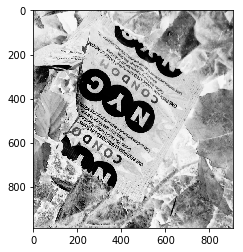





1
(826, 1490)


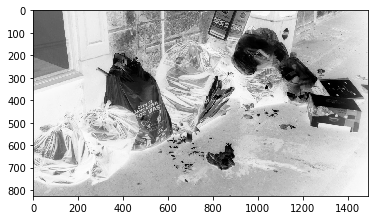





0
(1536, 2048)


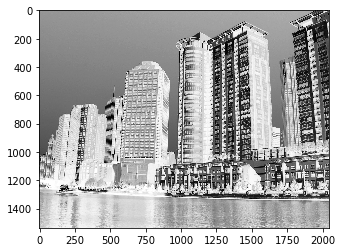





1
(125, 619)


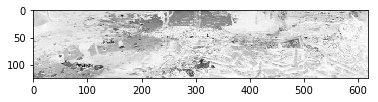





1
(125, 619)


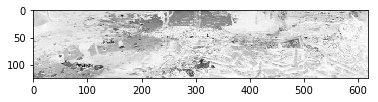

In [354]:
for i in range(5):
    random_no = np.random.randint(dataset.shape[0])
    print(labels[random_no])
    print(dataset[random_no].shape)
    plt.imshow(dataset[random_no], cmap='Greys')
    plt.show()
    
    print('\n\n\n')

## Data Pre-processing

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(987, 907)
(120, 120)


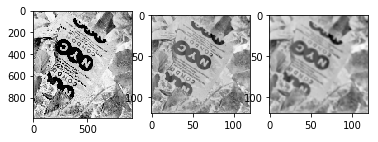

In [355]:
from sklearn.preprocessing import StandardScaler

std = StandardScaler()

img_idx = 110
std_img = std.fit_transform(dataset[img_idx])

print(std_img.shape)
std_img = cv2.resize(std_img, (120,120),interpolation=cv2.INTER_AREA)
blur_img = cv2.GaussianBlur(std_img, (3,3),0)
print(std_img.shape)
plt.subplot(1,3,1)
plt.imshow(dataset[img_idx], cmap='Greys')
plt.subplot(1,3,2)
plt.imshow(std_img, cmap='Greys')
plt.subplot(1,3,3)
plt.imshow(blur_img, cmap = 'Greys')



In [356]:
print("A Glance over Image matrix after Resizing, Scaling and Smoothing\nNotice: values are between -1 to 1\n\n",blur_img)

A Glance over Image matrix after Resizing, Scaling and Smoothing
Notice: values are between -1 to 1

 [[-0.05814033 -0.26539642 -0.78007151 ... -1.02388832 -1.07795607
  -0.99655416]
 [ 0.0488465  -0.16729355 -0.6799619  ... -1.23944434 -1.14713152
  -1.06999334]
 [ 0.01287555 -0.14299869 -0.46806989 ... -1.49964216 -1.25867096
  -1.16300116]
 ...
 [-0.64160319 -0.53820876 -0.33944843 ... -0.60673156 -0.56289148
  -0.54036121]
 [-0.57758853 -0.48125298 -0.37407784 ... -0.46896293 -0.6127414
  -0.68323084]
 [-0.57738265 -0.50744309 -0.47142424 ... -0.23050066 -0.51576654
  -0.72842673]]


In [357]:
from sklearn.preprocessing import StandardScaler
from sklearn.base import BaseEstimator, TransformerMixin

class Standardisation(BaseEstimator, TransformerMixin):
    def __init__(self, perform = True):
        self.perform = perform
        
    def fit(self,X, y=None):
        return self
    
    def transform(self,X, y=None):
        if self.perform:
            std = StandardScaler()
            X = std.fit_transform(X)
        return np.array(X)
    

class smoothening(BaseEstimator, TransformerMixin):
    
    def __init__(self, frame):
        self.frame = frame
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        blur_img = cv2.GaussianBlur(X, self.frame, 0)
        return blur_img
    
class Resize(BaseEstimator, TransformerMixin):
    
    def __int__(self):
        return self
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        size = (120,120)
        resized_img = cv2.resize(X, size, interpolation= cv2.INTER_AREA)
        return resized_img

    
def standardisation(img):
    std_scaler = StandardScaler()
    img = std_scaler.fit_transform(img)
    return img

def BlurImg(img):
    blur_img = cv2.GaussianBlur(img, (3,3), 0)
    return blur_img

def resize(img, w, h):
    r_img = cv2.resize(img, (w,h),interpolation=cv2.INTER_AREA)
    return r_img

In [358]:
## Preprocessing Data

preprocessed_data = []
for i in range(dataset.shape[0]):
    image = dataset[i]
    image_normalised = standardisation(image)
    img_resized = resize(image_normalised, 120,120)
    img_blur = BlurImg(img_resized)
    preprocessed_data.append(img_blur)

    #print(image.shape)
#     plt.subplot(1,3,1)
#     plt.imshow(image, cmap='Greys')
#     plt.subplot(1,3,2)
#     plt.imshow(image_normalised, cmap='Greys')
#     plt.subplot(1,3,3)
#     plt.imshow(img_blur, cmap = 'Greys')
#     #print(img_blur.shape)
   # print(img_blur)

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was conv

In [359]:
from sklearn.pipeline import Pipeline

preprocessing_pipeline = Pipeline([
    ('resize',Resize),
    ('standardization',Standardisation(perform = True)),
    ('Smoothing', smoothening(frame = (3,3)))
])

In [40]:
#processed_img = preprocessing_pipeline.fit_transform(dataset[110])

In [360]:
preprocessed_data = np.array(preprocessed_data)
preprocessed_data.shape

(397, 120, 120)

79 :  Garbage
(120, 120)


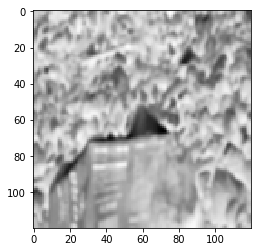





224 :  Not Garbage
(120, 120)


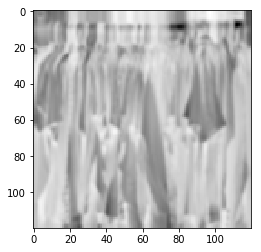





170 :  Garbage
(120, 120)


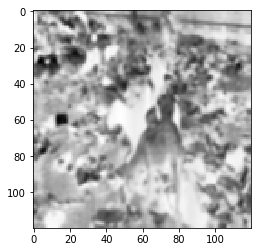





180 :  Garbage
(120, 120)


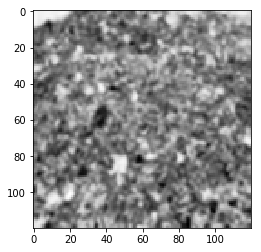





195 :  Not Garbage
(120, 120)


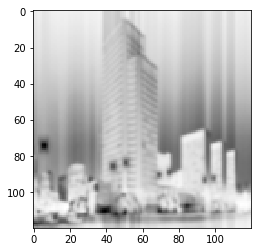

In [361]:
categories = ['Not Garbage', 'Garbage']
for i in range(5):
    random_no = np.random.randint(preprocessed_data.shape[0])
    print(random_no,': ',categories[labels[random_no]])
    print(preprocessed_data[random_no].shape)
    plt.imshow(preprocessed_data[random_no], cmap='Greys')
    plt.show()
    
    print('\n\n\n')

In [33]:
#dataset = np.delete(dataset, [347], 0)
#labels = np.delete(labels, [347], 0)

In [362]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(preprocessed_data, labels, test_size=0.3, random_state = 42, shuffle=True, stratify=labels)

In [363]:
s = f"""Total Training Samples: {X_train.shape[0]}
Train Garabage samples: {y_train[y_train == 1].shape[0]}
Train Non Garbage Samples: {y_train[y_train == 0].shape[0]}\n
Test Samples: {X_test.shape[0]}
Test Garabage samples: {y_test[y_test == 1].shape[0]}
Test Non Garbage Samples: {y_test[y_test == 0].shape[0]}"""

print(s)

Total Training Samples: 277
Train Garabage samples: 131
Train Non Garbage Samples: 146

Test Samples: 120
Test Garabage samples: 57
Test Non Garbage Samples: 63


In [364]:
X_train_org = X_train.copy()
X_test_org = X_test.copy()

In [368]:
train_data = []
test_data = []
for i in range(X_train.shape[0]):
    train_data.append(X_train[i].ravel())
    
for i in range(X_test.shape[0]):
    test_data.append(X_test[i].ravel())

In [369]:
X_train = np.array(train_data)
X_test = np.array(test_data)

In [370]:
X_train.shape

(277, 14400)

In [371]:
X_test.shape

(120, 14400)

In [372]:
from sklearn.ensemble import RandomForestClassifier

rf_model = RandomForestClassifier()

RF_model = rf_model.fit(X_train,y_train)

y_pred = RF_model.predict(X_test)

In [373]:
from sklearn.metrics import accuracy_score, confusion_matrix, precision_recall_fscore_support

score = accuracy_score(y_test, y_pred)
conf_m = confusion_matrix(y_test, y_pred)
precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred, average='weighted')

Precision 0.6187103594080339
Recall 0.6166666666666667
F1 score: 0.6089999999999999

0 - Non garbage
1 - Garbage


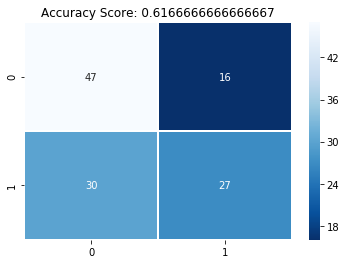

In [374]:
import seaborn as sns
plt.title(f'Accuracy Score: {score}')
sns.heatmap(conf_m, linewidths=0.5,cmap='Blues_r',annot=True,)
print(f'Precision {precision}\nRecall {recall}\nF1 score: {f1}\n\n0 - Non garbage\n1 - Garbage')

In [375]:
X_train.shape

(277, 14400)

In [377]:
X_train_org = X_train_org.reshape(277,120,120,1)
X_test_org = X_test_org.reshape(120,120,120,1)

In [400]:
import keras
from keras.models import Sequential, Model
from keras.layers import Dense, Flatten, Dropout
from keras.layers.convolutional import Conv2D, MaxPooling2D
from keras.optimizers import Adam

In [392]:
num_classes = 1

def cnn_model():
    model = Sequential()
    model.add(Conv2D(60,(5,5), input_shape=(120,120,1), activation='relu'))
    model.add(Conv2D(60, (5,5), activation='relu'))
    model.add(MaxPooling2D(pool_size = (2,2)))
    
    model.add(Conv2D(30, (3,3), activation='relu'))
    model.add(Conv2D(30, (3,3), activation = 'relu'))
    model.add(MaxPooling2D(pool_size=(2,2)))
    #model.add(Dropout(0.5))
    
    model.add(Flatten())
    model.add(Dense(units= 200,activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(num_classes, activation = 'sigmoid'))
    
    # Compile Model
    model.compile(Adam(lr=0.001), loss='mean_squared_error', metrics=['accuracy'])
    
    return model

In [393]:
model = cnn_model()
print(model.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 116, 116, 60)      1560      
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 112, 112, 60)      90060     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 56, 56, 60)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 54, 54, 30)        16230     
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 52, 52, 30)        8130      
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 26, 26, 30)        0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 20280)             0         
__________

In [395]:
history = model.fit(X_train_org, y_train, batch_size=30, epochs=10, validation_split=0.2)


Train on 221 samples, validate on 56 samples
Epoch 1/10


InternalError: cudaGetDevice() failed. Status: CUDA driver version is insufficient for CUDA runtime version

## Testing on ambiguous images

In [114]:
#os.listdir(cwd)
path = os.path.join(cwd, 'ambiguous-annotated-images')


In [131]:
test_images = []
for i in os.listdir(path):
    path1 = os.path.join(path,i)
    for j in os.listdir(path1):
        img_path = os.path.join(path1, j)
        test_images.append(img_path)
        

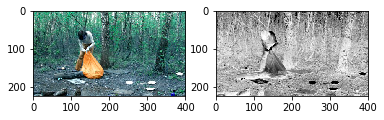

In [340]:
img_idx = 3
org_img = cv2.imread(test_images[img_idx])
test_img = cv2.imread(test_images[img_idx],0)
plt.subplot(1,2,1)
plt.imshow(org_img)
plt.subplot(1,2,2)
plt.imshow(test_img,cmap='Greys')
plt.show()

(224, 400)
(120, 120)


C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\Lenovo\Anaconda3\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


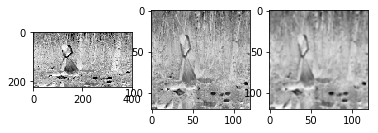

In [341]:

std_img = std.fit_transform(test_img)

print(std_img.shape)
std_img = cv2.resize(std_img, (120,120),interpolation=cv2.INTER_AREA)
blur_img = cv2.GaussianBlur(std_img, (3,3),0)
print(std_img.shape)
plt.subplot(1,3,1)
plt.imshow(test_img, cmap='Greys')
plt.subplot(1,3,2)
plt.imshow(std_img, cmap='Greys')
plt.subplot(1,3,3)
plt.imshow(blur_img, cmap = 'Greys')


In [342]:
img  = std_img.ravel()

img = img.reshape(1,-1)
#img.shape

prediction = RF_model.predict(img)
print(categories[prediction[0]])

Garbage


In [403]:
image = np.reshape(std_img,(1,120,120,1))
cnn_model = joblib.load('CNN_model.pkl')
prediction = cnn_model.predict(image)
print(categories[prediction[0]])

ModuleNotFoundError: No module named 'keras.engine.sequential'

## Serializing Model

In [345]:
save = False # Set it True to save model

if save:
    joblib.dump(RF_model,'RF_model_1.pkl')

['RF_model_1.pkl']

In [346]:
RF_model

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [402]:
from keras.engine import Model